# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

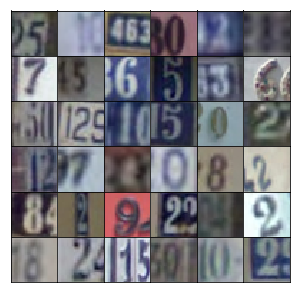

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(inputs=z, units=4*4*512, activation=None)
        
        # project and reshape
        x1 = tf.reshape(x, shape=(-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        # 1st onv layer
        x2 = tf.layers.conv2d_transpose(x1, 256, kernel_size=3, strides=2, padding='same', activation=None)
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256
        
        # 2nd conv layer
        x3 = tf.layers.conv2d_transpose(x2, 128, kernel_size=3, strides=2, padding='same', activation=None)
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, 3, kernel_size=3, strides=2, padding='same', activation=None)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 32, kernel_size=3, padding='same', activation=None)
        x1 = tf.maximum(alpha * x1, x1)
        # 16x16x32
        
        x2 = tf.layers.conv2d(x1, 64, kernel_size=3, padding='same', activation=None)
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x64
        
        x3 = tf.layers.conv2d(x2, 128, kernel_size=3, padding='same', activation=None)
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        # 4x4x128
        
        x4 = tf.layers.conv2d(x3, 64, kernel_size=3, padding='same', activation=None)
        x4 = tf.layers.batch_normalization(x4, training=True)
        x4 = tf.maximum(alpha * x4, x4)
        # 2x2x256
        
        flat = tf.reshape(x4, (-1, 2*2*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [17]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.6614... Generator Loss: 0.4034
Epoch 1/25... Discriminator Loss: 1.2918... Generator Loss: 0.6056
Epoch 1/25... Discriminator Loss: 1.0986... Generator Loss: 0.6859
Epoch 1/25... Discriminator Loss: 0.7351... Generator Loss: 1.1708
Epoch 1/25... Discriminator Loss: 0.7514... Generator Loss: 1.1106
Epoch 1/25... Discriminator Loss: 0.5851... Generator Loss: 1.2106
Epoch 1/25... Discriminator Loss: 0.6147... Generator Loss: 1.2877
Epoch 1/25... Discriminator Loss: 0.4387... Generator Loss: 1.6358
Epoch 1/25... Discriminator Loss: 0.3848... Generator Loss: 1.6600
Epoch 1/25... Discriminator Loss: 0.5038... Generator Loss: 1.4425


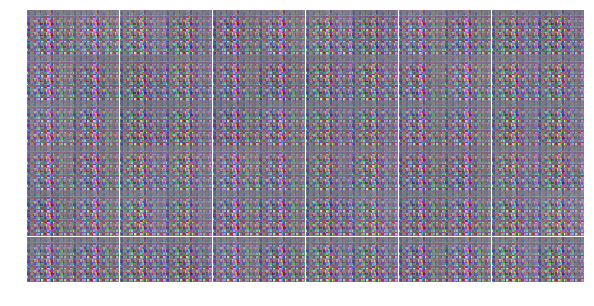

Epoch 1/25... Discriminator Loss: 0.2578... Generator Loss: 1.9300
Epoch 1/25... Discriminator Loss: 0.2653... Generator Loss: 1.9056
Epoch 1/25... Discriminator Loss: 0.2701... Generator Loss: 1.8207
Epoch 1/25... Discriminator Loss: 0.2281... Generator Loss: 2.2584
Epoch 1/25... Discriminator Loss: 0.2399... Generator Loss: 2.2605
Epoch 1/25... Discriminator Loss: 0.1420... Generator Loss: 2.5826
Epoch 1/25... Discriminator Loss: 0.1150... Generator Loss: 2.6579
Epoch 1/25... Discriminator Loss: 0.1177... Generator Loss: 2.6209
Epoch 1/25... Discriminator Loss: 0.1510... Generator Loss: 2.5101
Epoch 1/25... Discriminator Loss: 0.0864... Generator Loss: 2.8621


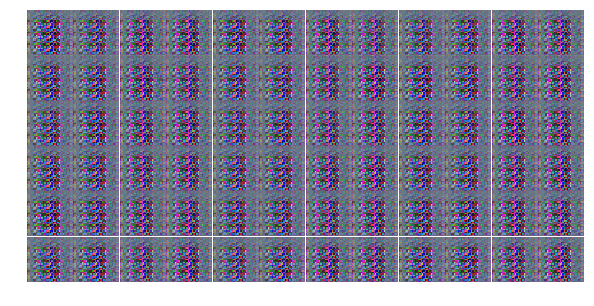

Epoch 1/25... Discriminator Loss: 0.0829... Generator Loss: 3.0836
Epoch 1/25... Discriminator Loss: 0.1031... Generator Loss: 3.0240
Epoch 1/25... Discriminator Loss: 0.1060... Generator Loss: 2.9037
Epoch 1/25... Discriminator Loss: 0.0969... Generator Loss: 2.8197
Epoch 1/25... Discriminator Loss: 0.1444... Generator Loss: 2.7088
Epoch 1/25... Discriminator Loss: 0.5232... Generator Loss: 2.2294
Epoch 1/25... Discriminator Loss: 0.9839... Generator Loss: 0.7523
Epoch 1/25... Discriminator Loss: 0.3821... Generator Loss: 1.6763
Epoch 1/25... Discriminator Loss: 0.7382... Generator Loss: 1.1717
Epoch 1/25... Discriminator Loss: 0.5457... Generator Loss: 1.6186


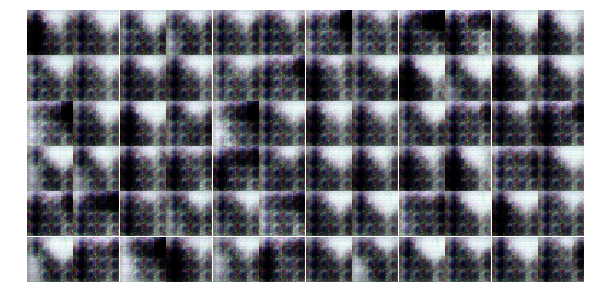

Epoch 1/25... Discriminator Loss: 0.3481... Generator Loss: 2.0374
Epoch 1/25... Discriminator Loss: 0.2419... Generator Loss: 2.5784
Epoch 1/25... Discriminator Loss: 0.4186... Generator Loss: 1.4796
Epoch 1/25... Discriminator Loss: 0.7844... Generator Loss: 0.9180
Epoch 1/25... Discriminator Loss: 0.1263... Generator Loss: 3.7986
Epoch 1/25... Discriminator Loss: 0.4387... Generator Loss: 1.3516
Epoch 1/25... Discriminator Loss: 0.2691... Generator Loss: 2.3746
Epoch 1/25... Discriminator Loss: 0.0971... Generator Loss: 4.4151
Epoch 1/25... Discriminator Loss: 0.2211... Generator Loss: 2.1613
Epoch 1/25... Discriminator Loss: 1.3287... Generator Loss: 3.1576


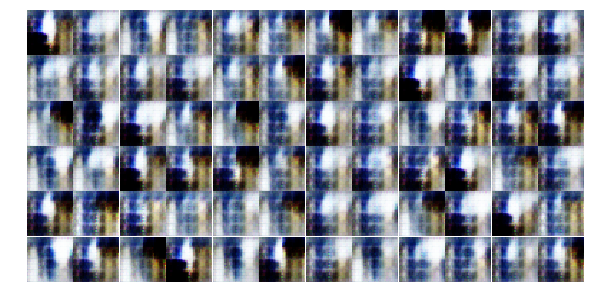

Epoch 1/25... Discriminator Loss: 0.4121... Generator Loss: 1.6415
Epoch 1/25... Discriminator Loss: 0.3260... Generator Loss: 2.1636
Epoch 1/25... Discriminator Loss: 0.1872... Generator Loss: 3.1056
Epoch 1/25... Discriminator Loss: 0.3625... Generator Loss: 1.6741
Epoch 1/25... Discriminator Loss: 1.0735... Generator Loss: 3.5557
Epoch 1/25... Discriminator Loss: 0.5335... Generator Loss: 1.2016
Epoch 1/25... Discriminator Loss: 0.5124... Generator Loss: 1.3093
Epoch 1/25... Discriminator Loss: 0.1996... Generator Loss: 4.7769
Epoch 1/25... Discriminator Loss: 0.4152... Generator Loss: 1.4138
Epoch 1/25... Discriminator Loss: 0.2180... Generator Loss: 5.0321


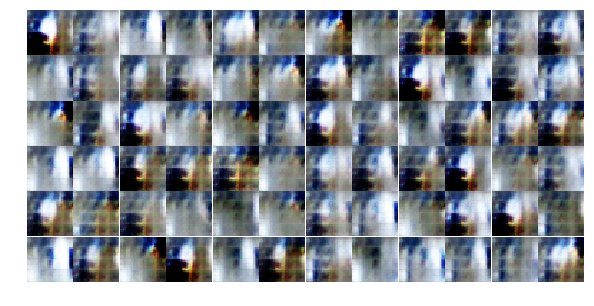

Epoch 1/25... Discriminator Loss: 0.6393... Generator Loss: 1.0346
Epoch 1/25... Discriminator Loss: 0.4423... Generator Loss: 1.5813
Epoch 1/25... Discriminator Loss: 0.2736... Generator Loss: 2.4180
Epoch 1/25... Discriminator Loss: 0.4256... Generator Loss: 1.4662
Epoch 1/25... Discriminator Loss: 0.1750... Generator Loss: 2.6322
Epoch 1/25... Discriminator Loss: 0.2042... Generator Loss: 4.5377
Epoch 1/25... Discriminator Loss: 0.4042... Generator Loss: 1.7232
Epoch 2/25... Discriminator Loss: 1.4681... Generator Loss: 1.9896
Epoch 2/25... Discriminator Loss: 0.7713... Generator Loss: 1.7474
Epoch 2/25... Discriminator Loss: 0.7194... Generator Loss: 0.9998


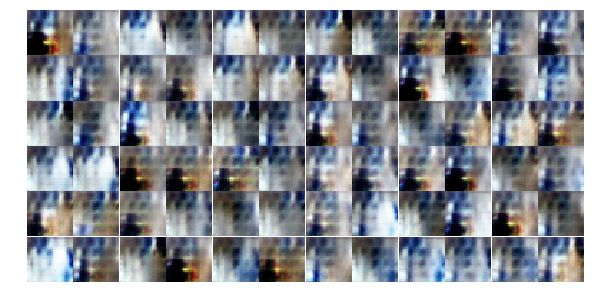

Epoch 2/25... Discriminator Loss: 0.2753... Generator Loss: 2.4828
Epoch 2/25... Discriminator Loss: 0.8027... Generator Loss: 4.8867
Epoch 2/25... Discriminator Loss: 0.2534... Generator Loss: 2.4787
Epoch 2/25... Discriminator Loss: 0.2019... Generator Loss: 3.0837
Epoch 2/25... Discriminator Loss: 0.3366... Generator Loss: 3.9735
Epoch 2/25... Discriminator Loss: 0.2197... Generator Loss: 2.4315
Epoch 2/25... Discriminator Loss: 0.3801... Generator Loss: 1.6699
Epoch 2/25... Discriminator Loss: 0.8892... Generator Loss: 2.5832
Epoch 2/25... Discriminator Loss: 0.1725... Generator Loss: 2.5475
Epoch 2/25... Discriminator Loss: 1.3326... Generator Loss: 3.4386


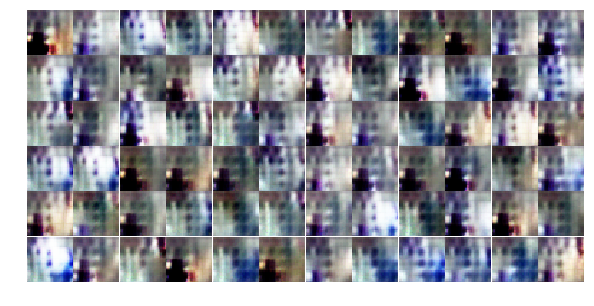

Epoch 2/25... Discriminator Loss: 0.3643... Generator Loss: 2.1727
Epoch 2/25... Discriminator Loss: 0.1838... Generator Loss: 3.2563
Epoch 2/25... Discriminator Loss: 0.1436... Generator Loss: 4.2194
Epoch 2/25... Discriminator Loss: 0.2177... Generator Loss: 3.8292
Epoch 2/25... Discriminator Loss: 0.5795... Generator Loss: 1.1662
Epoch 2/25... Discriminator Loss: 0.4744... Generator Loss: 1.5518
Epoch 2/25... Discriminator Loss: 0.7805... Generator Loss: 3.5492
Epoch 2/25... Discriminator Loss: 0.6977... Generator Loss: 3.1088
Epoch 2/25... Discriminator Loss: 0.4949... Generator Loss: 1.2244
Epoch 2/25... Discriminator Loss: 0.1294... Generator Loss: 3.0661


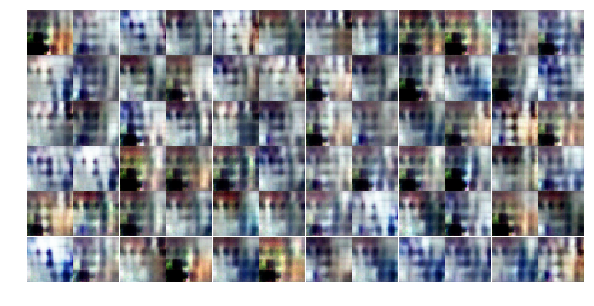

Epoch 2/25... Discriminator Loss: 0.2632... Generator Loss: 2.0009
Epoch 2/25... Discriminator Loss: 0.6107... Generator Loss: 1.0234
Epoch 2/25... Discriminator Loss: 0.0832... Generator Loss: 3.7418
Epoch 2/25... Discriminator Loss: 0.0836... Generator Loss: 3.3876
Epoch 2/25... Discriminator Loss: 0.1706... Generator Loss: 4.6420
Epoch 2/25... Discriminator Loss: 0.4710... Generator Loss: 1.3578
Epoch 2/25... Discriminator Loss: 0.0603... Generator Loss: 7.3781
Epoch 2/25... Discriminator Loss: 0.2283... Generator Loss: 2.4361
Epoch 2/25... Discriminator Loss: 0.1592... Generator Loss: 3.5989
Epoch 2/25... Discriminator Loss: 0.4678... Generator Loss: 4.0555


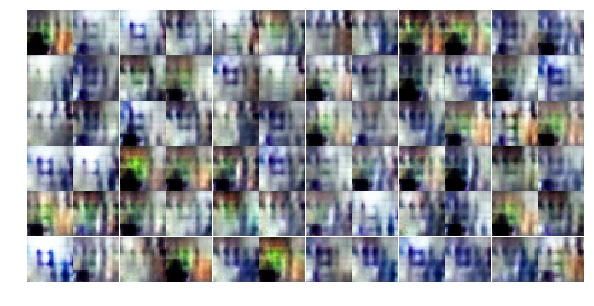

Epoch 2/25... Discriminator Loss: 0.0621... Generator Loss: 5.1558
Epoch 2/25... Discriminator Loss: 0.0483... Generator Loss: 4.3162
Epoch 2/25... Discriminator Loss: 0.4195... Generator Loss: 1.5007
Epoch 2/25... Discriminator Loss: 0.0954... Generator Loss: 6.3305
Epoch 2/25... Discriminator Loss: 0.1407... Generator Loss: 7.2887
Epoch 2/25... Discriminator Loss: 0.1069... Generator Loss: 6.3101
Epoch 2/25... Discriminator Loss: 1.8913... Generator Loss: 0.7125
Epoch 2/25... Discriminator Loss: 0.4846... Generator Loss: 2.6303
Epoch 2/25... Discriminator Loss: 0.5036... Generator Loss: 1.5335
Epoch 2/25... Discriminator Loss: 0.9138... Generator Loss: 1.1804


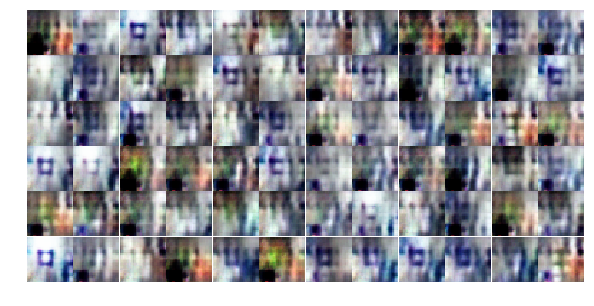

Epoch 2/25... Discriminator Loss: 0.2418... Generator Loss: 3.6900
Epoch 2/25... Discriminator Loss: 0.0801... Generator Loss: 4.9684
Epoch 2/25... Discriminator Loss: 0.1318... Generator Loss: 3.3306
Epoch 2/25... Discriminator Loss: 0.0890... Generator Loss: 4.0742
Epoch 2/25... Discriminator Loss: 0.0843... Generator Loss: 3.7816
Epoch 2/25... Discriminator Loss: 0.0892... Generator Loss: 4.9331
Epoch 2/25... Discriminator Loss: 0.0756... Generator Loss: 3.4759
Epoch 2/25... Discriminator Loss: 0.2193... Generator Loss: 2.2000
Epoch 2/25... Discriminator Loss: 0.1465... Generator Loss: 3.5451
Epoch 2/25... Discriminator Loss: 0.1400... Generator Loss: 2.7656


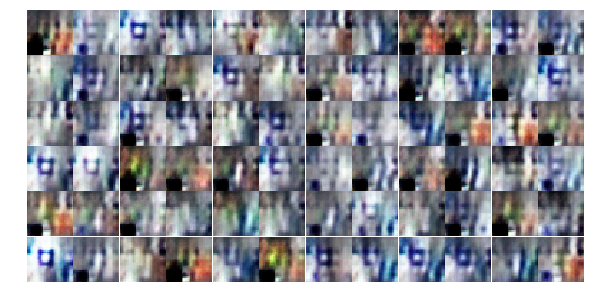

Epoch 2/25... Discriminator Loss: 0.0397... Generator Loss: 6.6845
Epoch 2/25... Discriminator Loss: 0.0836... Generator Loss: 8.9689
Epoch 2/25... Discriminator Loss: 0.0635... Generator Loss: 4.3472
Epoch 2/25... Discriminator Loss: 0.1161... Generator Loss: 6.9138
Epoch 3/25... Discriminator Loss: 0.2509... Generator Loss: 1.9024
Epoch 3/25... Discriminator Loss: 0.1049... Generator Loss: 5.4023
Epoch 3/25... Discriminator Loss: 0.6070... Generator Loss: 1.5459
Epoch 3/25... Discriminator Loss: 0.0870... Generator Loss: 6.2586
Epoch 3/25... Discriminator Loss: 0.2000... Generator Loss: 2.2488
Epoch 3/25... Discriminator Loss: 0.5361... Generator Loss: 1.2650


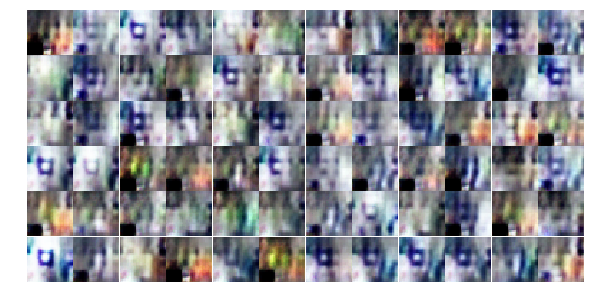

Epoch 3/25... Discriminator Loss: 2.4673... Generator Loss: 6.3954
Epoch 3/25... Discriminator Loss: 0.6551... Generator Loss: 1.0504
Epoch 3/25... Discriminator Loss: 0.0812... Generator Loss: 4.2162
Epoch 3/25... Discriminator Loss: 0.1350... Generator Loss: 4.2478
Epoch 3/25... Discriminator Loss: 0.9785... Generator Loss: 0.6299
Epoch 3/25... Discriminator Loss: 0.1560... Generator Loss: 3.1865
Epoch 3/25... Discriminator Loss: 0.2748... Generator Loss: 5.3167
Epoch 3/25... Discriminator Loss: 0.0286... Generator Loss: 4.5300
Epoch 3/25... Discriminator Loss: 0.2439... Generator Loss: 2.7979
Epoch 3/25... Discriminator Loss: 0.0657... Generator Loss: 4.7680


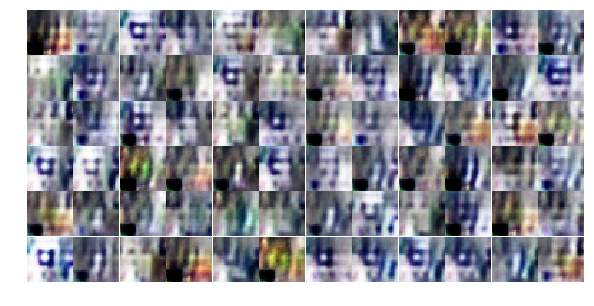

Epoch 3/25... Discriminator Loss: 0.0986... Generator Loss: 3.9228
Epoch 3/25... Discriminator Loss: 0.2095... Generator Loss: 2.0729
Epoch 3/25... Discriminator Loss: 0.0586... Generator Loss: 5.4329
Epoch 3/25... Discriminator Loss: 0.0597... Generator Loss: 8.1916
Epoch 3/25... Discriminator Loss: 0.1749... Generator Loss: 2.3890
Epoch 3/25... Discriminator Loss: 0.1236... Generator Loss: 4.0528
Epoch 3/25... Discriminator Loss: 0.2610... Generator Loss: 4.7533
Epoch 3/25... Discriminator Loss: 0.0987... Generator Loss: 8.4957
Epoch 3/25... Discriminator Loss: 0.2094... Generator Loss: 2.3011
Epoch 3/25... Discriminator Loss: 0.0962... Generator Loss: 8.2091


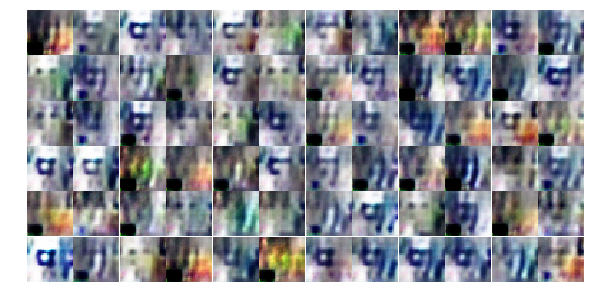

Epoch 3/25... Discriminator Loss: 0.1844... Generator Loss: 3.0847
Epoch 3/25... Discriminator Loss: 0.0337... Generator Loss: 8.2432
Epoch 3/25... Discriminator Loss: 0.0148... Generator Loss: 6.3995
Epoch 3/25... Discriminator Loss: 0.0409... Generator Loss: 7.0755
Epoch 3/25... Discriminator Loss: 0.1500... Generator Loss: 2.8023
Epoch 3/25... Discriminator Loss: 0.0741... Generator Loss: 8.9860
Epoch 3/25... Discriminator Loss: 0.1513... Generator Loss: 2.9327
Epoch 3/25... Discriminator Loss: 0.0283... Generator Loss: 6.3188
Epoch 3/25... Discriminator Loss: 0.3680... Generator Loss: 1.5860
Epoch 3/25... Discriminator Loss: 0.0277... Generator Loss: 7.3940


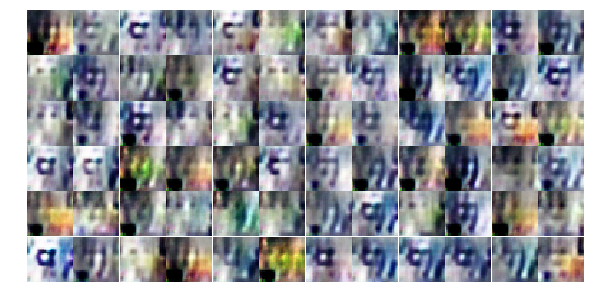

Epoch 3/25... Discriminator Loss: 0.7114... Generator Loss: 0.9695
Epoch 3/25... Discriminator Loss: 0.0955... Generator Loss: 6.0366
Epoch 3/25... Discriminator Loss: 0.0607... Generator Loss: 6.1507
Epoch 3/25... Discriminator Loss: 0.0529... Generator Loss: 6.9808
Epoch 3/25... Discriminator Loss: 0.0699... Generator Loss: 5.7761
Epoch 3/25... Discriminator Loss: 0.0444... Generator Loss: 4.9125
Epoch 3/25... Discriminator Loss: 0.1819... Generator Loss: 5.7413
Epoch 3/25... Discriminator Loss: 0.4600... Generator Loss: 4.6248
Epoch 3/25... Discriminator Loss: 0.0437... Generator Loss: 6.4399
Epoch 3/25... Discriminator Loss: 0.0111... Generator Loss: 8.7187


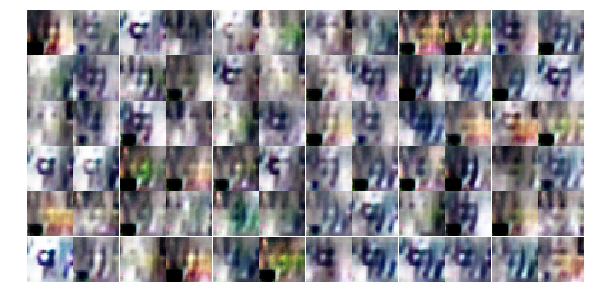

Epoch 3/25... Discriminator Loss: 0.0958... Generator Loss: 3.1313
Epoch 3/25... Discriminator Loss: 0.2826... Generator Loss: 1.8969
Epoch 3/25... Discriminator Loss: 0.2772... Generator Loss: 9.4541
Epoch 3/25... Discriminator Loss: 0.0581... Generator Loss: 5.4697
Epoch 3/25... Discriminator Loss: 0.0275... Generator Loss: 6.0062
Epoch 3/25... Discriminator Loss: 0.0094... Generator Loss: 10.0366
Epoch 3/25... Discriminator Loss: 0.0064... Generator Loss: 8.0456
Epoch 3/25... Discriminator Loss: 0.0423... Generator Loss: 6.6846
Epoch 3/25... Discriminator Loss: 0.0398... Generator Loss: 6.8715
Epoch 3/25... Discriminator Loss: 0.0200... Generator Loss: 6.2504


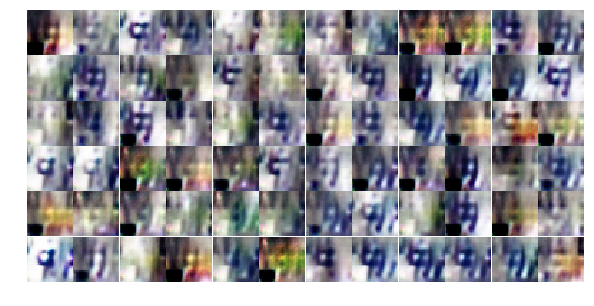

Epoch 3/25... Discriminator Loss: 0.0276... Generator Loss: 10.3132
Epoch 4/25... Discriminator Loss: 0.0352... Generator Loss: 5.2707
Epoch 4/25... Discriminator Loss: 1.6656... Generator Loss: 0.3765
Epoch 4/25... Discriminator Loss: 0.3478... Generator Loss: 5.3467
Epoch 4/25... Discriminator Loss: 0.0249... Generator Loss: 5.1799
Epoch 4/25... Discriminator Loss: 0.0799... Generator Loss: 3.9227
Epoch 4/25... Discriminator Loss: 0.0260... Generator Loss: 8.1690
Epoch 4/25... Discriminator Loss: 0.0670... Generator Loss: 6.6437
Epoch 4/25... Discriminator Loss: 0.0449... Generator Loss: 9.4050
Epoch 4/25... Discriminator Loss: 0.0517... Generator Loss: 10.2856


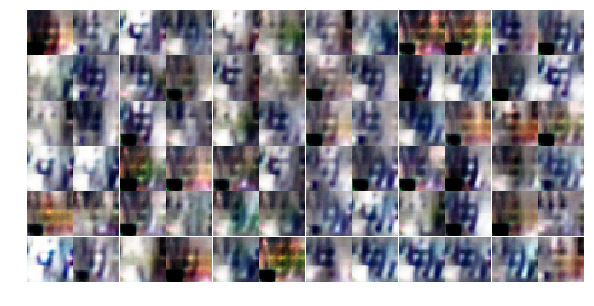

Epoch 4/25... Discriminator Loss: 0.0102... Generator Loss: 8.9361
Epoch 4/25... Discriminator Loss: 0.0458... Generator Loss: 4.6227
Epoch 4/25... Discriminator Loss: 0.0901... Generator Loss: 6.4311
Epoch 4/25... Discriminator Loss: 0.0184... Generator Loss: 8.9313
Epoch 4/25... Discriminator Loss: 0.0596... Generator Loss: 3.6024
Epoch 4/25... Discriminator Loss: 0.0205... Generator Loss: 8.3996
Epoch 4/25... Discriminator Loss: 0.0192... Generator Loss: 9.6655
Epoch 4/25... Discriminator Loss: 0.0378... Generator Loss: 4.0443
Epoch 4/25... Discriminator Loss: 0.1338... Generator Loss: 2.8467
Epoch 4/25... Discriminator Loss: 0.0085... Generator Loss: 7.4764


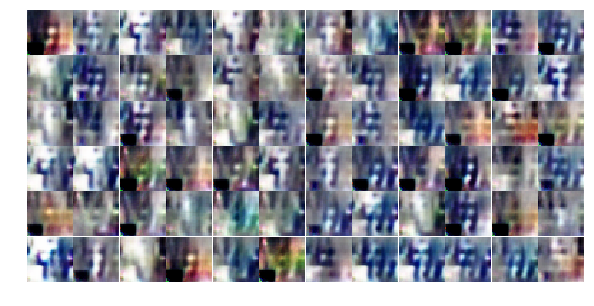

Epoch 4/25... Discriminator Loss: 0.8949... Generator Loss: 0.7435
Epoch 4/25... Discriminator Loss: 0.2448... Generator Loss: 2.6038
Epoch 4/25... Discriminator Loss: 0.0097... Generator Loss: 8.6708
Epoch 4/25... Discriminator Loss: 0.0295... Generator Loss: 6.2225
Epoch 4/25... Discriminator Loss: 0.0340... Generator Loss: 5.5258
Epoch 4/25... Discriminator Loss: 0.0130... Generator Loss: 10.1240
Epoch 4/25... Discriminator Loss: 0.0211... Generator Loss: 9.6125
Epoch 4/25... Discriminator Loss: 0.0078... Generator Loss: 9.5307
Epoch 4/25... Discriminator Loss: 0.0329... Generator Loss: 7.5051
Epoch 4/25... Discriminator Loss: 0.0381... Generator Loss: 5.2546


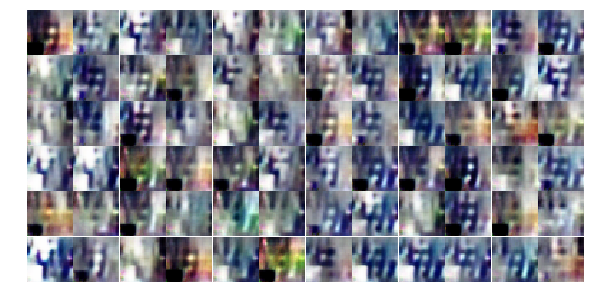

Epoch 4/25... Discriminator Loss: 0.0074... Generator Loss: 8.6408
Epoch 4/25... Discriminator Loss: 0.0088... Generator Loss: 10.1849
Epoch 4/25... Discriminator Loss: 0.0153... Generator Loss: 9.2250
Epoch 4/25... Discriminator Loss: 0.0096... Generator Loss: 6.9456
Epoch 4/25... Discriminator Loss: 0.0428... Generator Loss: 10.3891
Epoch 4/25... Discriminator Loss: 0.1470... Generator Loss: 2.5166
Epoch 4/25... Discriminator Loss: 0.0110... Generator Loss: 9.1694
Epoch 4/25... Discriminator Loss: 0.0151... Generator Loss: 5.1134
Epoch 4/25... Discriminator Loss: 0.2997... Generator Loss: 2.6594
Epoch 4/25... Discriminator Loss: 0.0945... Generator Loss: 10.0012


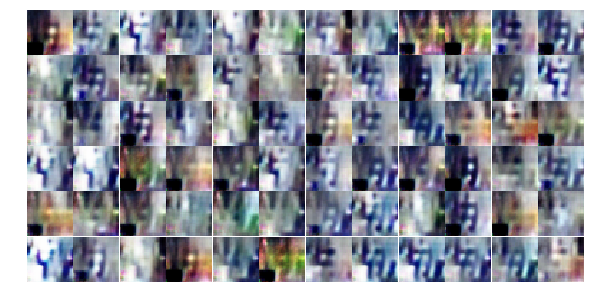

Epoch 4/25... Discriminator Loss: 0.0062... Generator Loss: 7.3765
Epoch 4/25... Discriminator Loss: 0.0355... Generator Loss: 5.6011
Epoch 4/25... Discriminator Loss: 0.0076... Generator Loss: 8.7547
Epoch 4/25... Discriminator Loss: 0.1647... Generator Loss: 2.4252
Epoch 4/25... Discriminator Loss: 0.0108... Generator Loss: 6.4952
Epoch 4/25... Discriminator Loss: 0.0149... Generator Loss: 8.8057
Epoch 4/25... Discriminator Loss: 0.0569... Generator Loss: 3.5364
Epoch 4/25... Discriminator Loss: 0.1096... Generator Loss: 8.6589
Epoch 4/25... Discriminator Loss: 0.0020... Generator Loss: 8.7733
Epoch 4/25... Discriminator Loss: 0.0039... Generator Loss: 10.0558


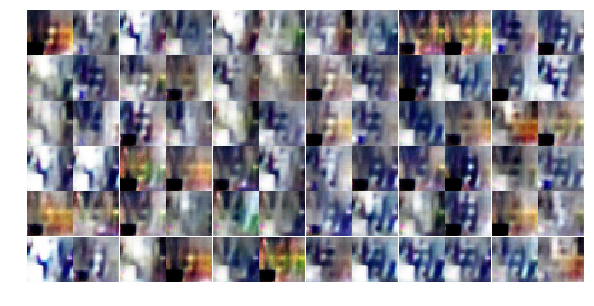

Epoch 4/25... Discriminator Loss: 0.0090... Generator Loss: 8.1711
Epoch 4/25... Discriminator Loss: 0.0100... Generator Loss: 8.2100
Epoch 4/25... Discriminator Loss: 0.0132... Generator Loss: 5.4013
Epoch 4/25... Discriminator Loss: 0.0069... Generator Loss: 6.0013
Epoch 4/25... Discriminator Loss: 0.0119... Generator Loss: 10.5203
Epoch 4/25... Discriminator Loss: 0.0058... Generator Loss: 8.1508
Epoch 4/25... Discriminator Loss: 0.0062... Generator Loss: 9.8914
Epoch 4/25... Discriminator Loss: 0.0240... Generator Loss: 9.0458
Epoch 4/25... Discriminator Loss: 0.0197... Generator Loss: 10.2630
Epoch 5/25... Discriminator Loss: 0.0260... Generator Loss: 9.2357


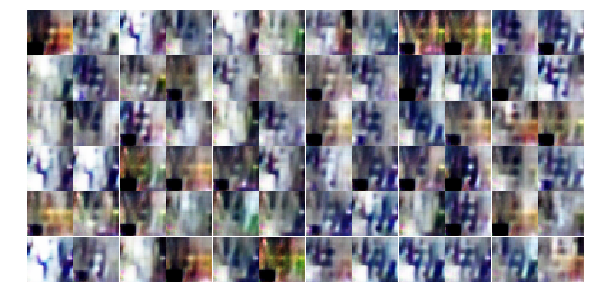

Epoch 5/25... Discriminator Loss: 0.1200... Generator Loss: 10.4627
Epoch 5/25... Discriminator Loss: 0.1824... Generator Loss: 2.0869
Epoch 5/25... Discriminator Loss: 0.0559... Generator Loss: 3.9880
Epoch 5/25... Discriminator Loss: 0.0248... Generator Loss: 10.9718
Epoch 5/25... Discriminator Loss: 0.0035... Generator Loss: 9.2217
Epoch 5/25... Discriminator Loss: 0.0176... Generator Loss: 5.0851
Epoch 5/25... Discriminator Loss: 0.0089... Generator Loss: 6.3737
Epoch 5/25... Discriminator Loss: 0.0613... Generator Loss: 3.4034
Epoch 5/25... Discriminator Loss: 0.0092... Generator Loss: 10.0228
Epoch 5/25... Discriminator Loss: 0.1302... Generator Loss: 2.5938


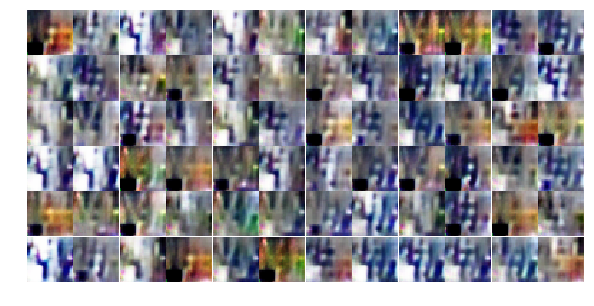

Epoch 5/25... Discriminator Loss: 0.0096... Generator Loss: 10.7192
Epoch 5/25... Discriminator Loss: 0.0038... Generator Loss: 9.5108
Epoch 5/25... Discriminator Loss: 0.0176... Generator Loss: 5.5420
Epoch 5/25... Discriminator Loss: 0.1250... Generator Loss: 2.7842
Epoch 5/25... Discriminator Loss: 0.0186... Generator Loss: 10.3150
Epoch 5/25... Discriminator Loss: 0.0979... Generator Loss: 2.8119
Epoch 5/25... Discriminator Loss: 0.0167... Generator Loss: 5.8390
Epoch 5/25... Discriminator Loss: 0.0260... Generator Loss: 4.3795
Epoch 5/25... Discriminator Loss: 0.0232... Generator Loss: 11.5494
Epoch 5/25... Discriminator Loss: 0.0025... Generator Loss: 8.7472


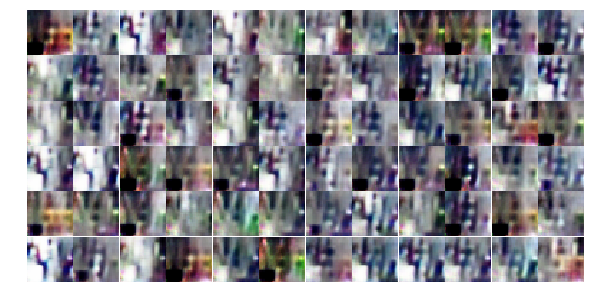

Epoch 5/25... Discriminator Loss: 0.0105... Generator Loss: 5.4607
Epoch 5/25... Discriminator Loss: 0.0040... Generator Loss: 8.8995
Epoch 5/25... Discriminator Loss: 0.0068... Generator Loss: 8.1852
Epoch 5/25... Discriminator Loss: 1.5406... Generator Loss: 2.7838
Epoch 5/25... Discriminator Loss: 1.4069... Generator Loss: 0.4292
Epoch 5/25... Discriminator Loss: 0.1122... Generator Loss: 5.7784
Epoch 5/25... Discriminator Loss: 0.0615... Generator Loss: 4.4069
Epoch 5/25... Discriminator Loss: 0.0671... Generator Loss: 7.2549
Epoch 5/25... Discriminator Loss: 0.0476... Generator Loss: 6.0299
Epoch 5/25... Discriminator Loss: 0.0239... Generator Loss: 9.7921


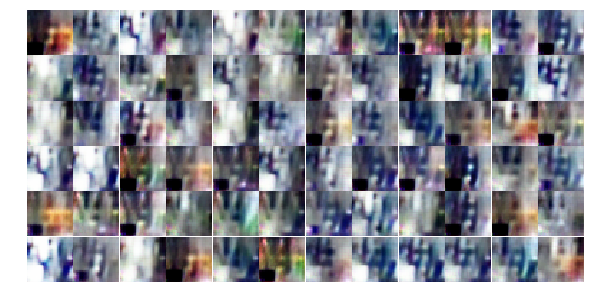

Epoch 5/25... Discriminator Loss: 0.0072... Generator Loss: 7.1527
Epoch 5/25... Discriminator Loss: 0.1054... Generator Loss: 2.7508
Epoch 5/25... Discriminator Loss: 0.0086... Generator Loss: 10.4302
Epoch 5/25... Discriminator Loss: 0.0027... Generator Loss: 8.2311
Epoch 5/25... Discriminator Loss: 0.0367... Generator Loss: 10.3983
Epoch 5/25... Discriminator Loss: 0.1629... Generator Loss: 2.3503
Epoch 5/25... Discriminator Loss: 0.0135... Generator Loss: 7.9391
Epoch 5/25... Discriminator Loss: 0.0054... Generator Loss: 10.2896
Epoch 5/25... Discriminator Loss: 0.0091... Generator Loss: 5.5509
Epoch 5/25... Discriminator Loss: 0.0135... Generator Loss: 9.2317


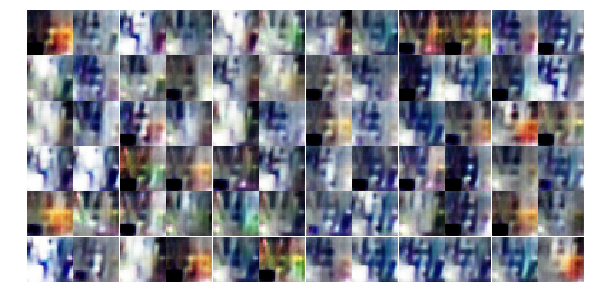

Epoch 5/25... Discriminator Loss: 0.0103... Generator Loss: 9.7980
Epoch 5/25... Discriminator Loss: 0.0208... Generator Loss: 10.7575
Epoch 5/25... Discriminator Loss: 0.0017... Generator Loss: 9.2116
Epoch 5/25... Discriminator Loss: 0.0071... Generator Loss: 6.8834
Epoch 5/25... Discriminator Loss: 0.0727... Generator Loss: 3.3647
Epoch 5/25... Discriminator Loss: 0.0039... Generator Loss: 9.8941
Epoch 5/25... Discriminator Loss: 0.0805... Generator Loss: 3.1010
Epoch 5/25... Discriminator Loss: 0.0147... Generator Loss: 11.0524
Epoch 5/25... Discriminator Loss: 0.0352... Generator Loss: 6.2998
Epoch 5/25... Discriminator Loss: 0.0032... Generator Loss: 10.7126


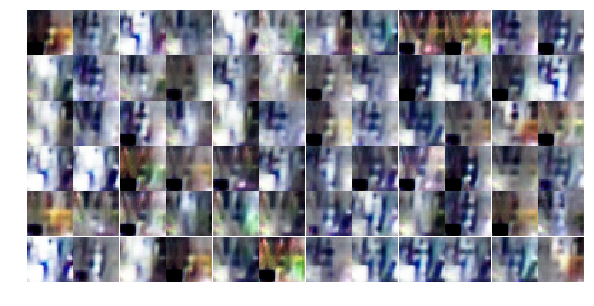

Epoch 5/25... Discriminator Loss: 0.0451... Generator Loss: 3.7086
Epoch 5/25... Discriminator Loss: 0.0144... Generator Loss: 5.3941
Epoch 5/25... Discriminator Loss: 0.0021... Generator Loss: 8.0025
Epoch 5/25... Discriminator Loss: 0.0161... Generator Loss: 10.7568
Epoch 5/25... Discriminator Loss: 0.0139... Generator Loss: 6.4172
Epoch 5/25... Discriminator Loss: 0.0045... Generator Loss: 8.3116
Epoch 6/25... Discriminator Loss: 0.0078... Generator Loss: 9.5920
Epoch 6/25... Discriminator Loss: 0.0065... Generator Loss: 9.7736
Epoch 6/25... Discriminator Loss: 0.0383... Generator Loss: 10.1365
Epoch 6/25... Discriminator Loss: 0.0029... Generator Loss: 8.1548


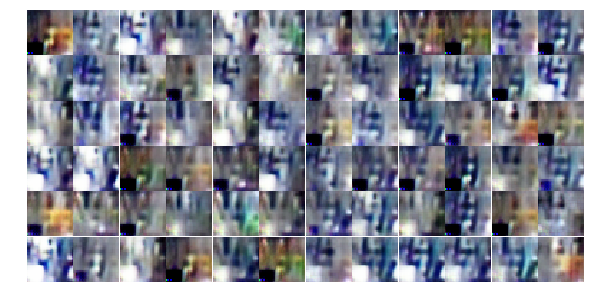

Epoch 6/25... Discriminator Loss: 0.0189... Generator Loss: 9.8636
Epoch 6/25... Discriminator Loss: 0.0355... Generator Loss: 4.0616
Epoch 6/25... Discriminator Loss: 0.0033... Generator Loss: 9.8066
Epoch 6/25... Discriminator Loss: 0.0121... Generator Loss: 5.4875
Epoch 6/25... Discriminator Loss: 0.0103... Generator Loss: 6.2083
Epoch 6/25... Discriminator Loss: 0.0269... Generator Loss: 5.5717
Epoch 6/25... Discriminator Loss: 0.0115... Generator Loss: 8.0799
Epoch 6/25... Discriminator Loss: 0.0324... Generator Loss: 10.0702
Epoch 6/25... Discriminator Loss: 0.0028... Generator Loss: 11.6462
Epoch 6/25... Discriminator Loss: 0.0020... Generator Loss: 10.7646


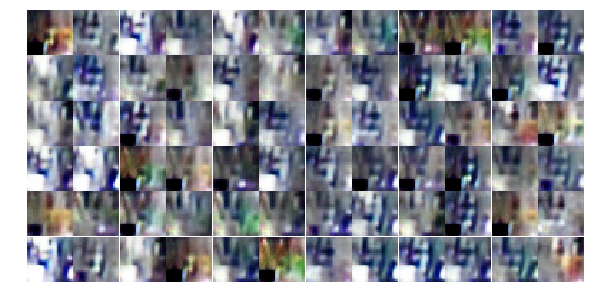

Epoch 6/25... Discriminator Loss: 0.0279... Generator Loss: 4.5178
Epoch 6/25... Discriminator Loss: 0.0299... Generator Loss: 9.8785
Epoch 6/25... Discriminator Loss: 0.0235... Generator Loss: 12.0121
Epoch 6/25... Discriminator Loss: 0.0045... Generator Loss: 9.2365
Epoch 6/25... Discriminator Loss: 0.0046... Generator Loss: 7.7777
Epoch 6/25... Discriminator Loss: 0.0024... Generator Loss: 7.4071
Epoch 6/25... Discriminator Loss: 0.0027... Generator Loss: 7.2378
Epoch 6/25... Discriminator Loss: 0.0026... Generator Loss: 7.1337
Epoch 6/25... Discriminator Loss: 0.0029... Generator Loss: 7.0619
Epoch 6/25... Discriminator Loss: 0.0043... Generator Loss: 6.9774


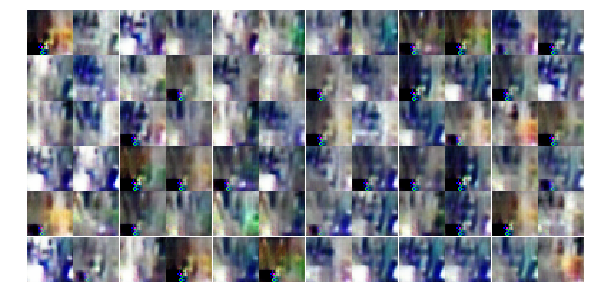

Epoch 6/25... Discriminator Loss: 0.0029... Generator Loss: 6.8110
Epoch 6/25... Discriminator Loss: 0.0029... Generator Loss: 6.8287
Epoch 6/25... Discriminator Loss: 0.0027... Generator Loss: 6.6729
Epoch 6/25... Discriminator Loss: 0.0059... Generator Loss: 6.7077
Epoch 6/25... Discriminator Loss: 0.0034... Generator Loss: 6.6690
Epoch 6/25... Discriminator Loss: 0.0031... Generator Loss: 6.7249
Epoch 6/25... Discriminator Loss: 0.0026... Generator Loss: 6.6647
Epoch 6/25... Discriminator Loss: 0.0040... Generator Loss: 6.5044
Epoch 6/25... Discriminator Loss: 0.0033... Generator Loss: 6.5459
Epoch 6/25... Discriminator Loss: 0.0029... Generator Loss: 6.5392


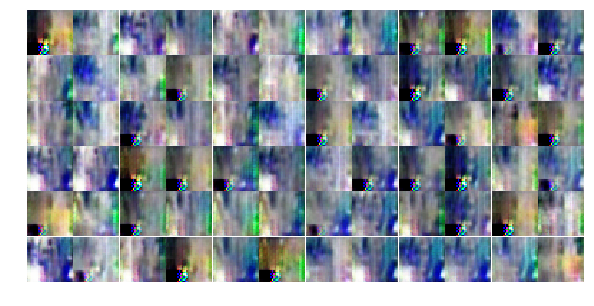

Epoch 6/25... Discriminator Loss: 0.0029... Generator Loss: 6.4862
Epoch 6/25... Discriminator Loss: 0.0031... Generator Loss: 6.5443
Epoch 6/25... Discriminator Loss: 0.0026... Generator Loss: 6.5593
Epoch 6/25... Discriminator Loss: 0.0027... Generator Loss: 6.5789
Epoch 6/25... Discriminator Loss: 0.0025... Generator Loss: 6.6075
Epoch 6/25... Discriminator Loss: 0.0025... Generator Loss: 6.5545
Epoch 6/25... Discriminator Loss: 0.0025... Generator Loss: 6.6169
Epoch 6/25... Discriminator Loss: 0.0027... Generator Loss: 6.5724
Epoch 6/25... Discriminator Loss: 0.0026... Generator Loss: 6.5900
Epoch 6/25... Discriminator Loss: 0.0027... Generator Loss: 6.5914


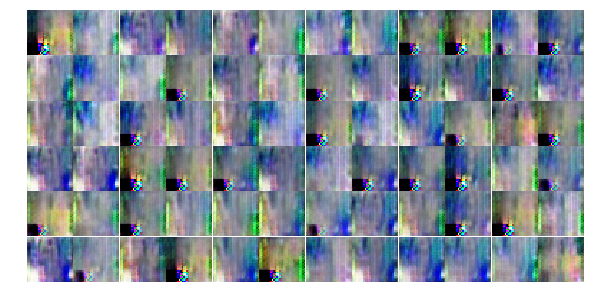

Epoch 6/25... Discriminator Loss: 0.0030... Generator Loss: 6.5381
Epoch 6/25... Discriminator Loss: 0.0026... Generator Loss: 6.5768
Epoch 6/25... Discriminator Loss: 0.0030... Generator Loss: 6.5352
Epoch 6/25... Discriminator Loss: 0.0029... Generator Loss: 6.5937
Epoch 6/25... Discriminator Loss: 0.0032... Generator Loss: 6.5448
Epoch 6/25... Discriminator Loss: 0.0031... Generator Loss: 6.5735
Epoch 6/25... Discriminator Loss: 0.0036... Generator Loss: 6.5531
Epoch 6/25... Discriminator Loss: 0.0036... Generator Loss: 6.5157
Epoch 6/25... Discriminator Loss: 0.0037... Generator Loss: 6.4945
Epoch 6/25... Discriminator Loss: 0.0027... Generator Loss: 6.5451


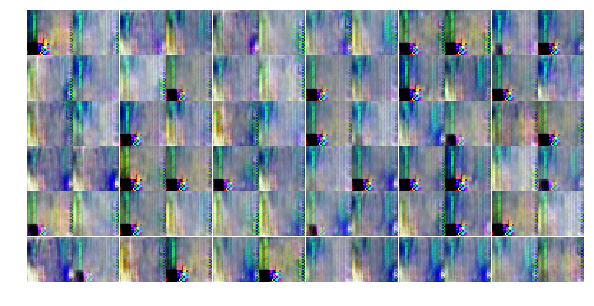

Epoch 6/25... Discriminator Loss: 0.0031... Generator Loss: 6.4724
Epoch 6/25... Discriminator Loss: 0.0030... Generator Loss: 6.4962
Epoch 6/25... Discriminator Loss: 0.0026... Generator Loss: 6.4723
Epoch 7/25... Discriminator Loss: 0.0031... Generator Loss: 6.3921
Epoch 7/25... Discriminator Loss: 0.0026... Generator Loss: 6.4586
Epoch 7/25... Discriminator Loss: 0.0027... Generator Loss: 6.4663
Epoch 7/25... Discriminator Loss: 0.0027... Generator Loss: 6.4530
Epoch 7/25... Discriminator Loss: 0.0031... Generator Loss: 6.4624
Epoch 7/25... Discriminator Loss: 0.0036... Generator Loss: 6.4239
Epoch 7/25... Discriminator Loss: 0.0033... Generator Loss: 6.3475


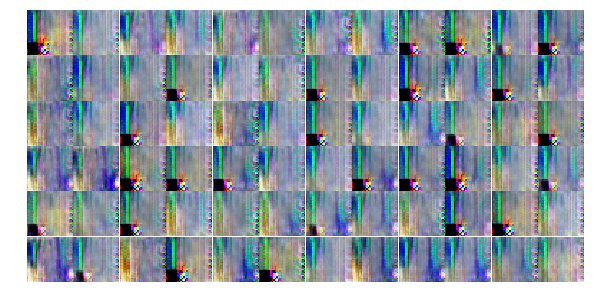

Epoch 7/25... Discriminator Loss: 0.0033... Generator Loss: 6.3517
Epoch 7/25... Discriminator Loss: 0.0031... Generator Loss: 6.3658
Epoch 7/25... Discriminator Loss: 0.0038... Generator Loss: 6.3625
Epoch 7/25... Discriminator Loss: 0.0027... Generator Loss: 6.4403
Epoch 7/25... Discriminator Loss: 0.0026... Generator Loss: 6.4824
Epoch 7/25... Discriminator Loss: 0.0030... Generator Loss: 6.4849
Epoch 7/25... Discriminator Loss: 0.0027... Generator Loss: 6.4865
Epoch 7/25... Discriminator Loss: 0.0026... Generator Loss: 6.5251
Epoch 7/25... Discriminator Loss: 0.0029... Generator Loss: 6.4544
Epoch 7/25... Discriminator Loss: 0.0028... Generator Loss: 6.6532


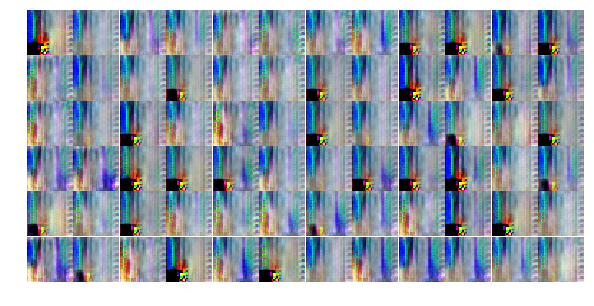

Epoch 7/25... Discriminator Loss: 0.0021... Generator Loss: 6.8679
Epoch 7/25... Discriminator Loss: 0.0035... Generator Loss: 6.2416
Epoch 7/25... Discriminator Loss: 0.0010... Generator Loss: 7.9125
Epoch 7/25... Discriminator Loss: 0.0036... Generator Loss: 6.3022
Epoch 7/25... Discriminator Loss: 0.0036... Generator Loss: 6.5846
Epoch 7/25... Discriminator Loss: 0.0012... Generator Loss: 10.1936
Epoch 7/25... Discriminator Loss: 0.0008... Generator Loss: 8.9027
Epoch 7/25... Discriminator Loss: 0.0025... Generator Loss: 6.6381
Epoch 7/25... Discriminator Loss: 0.0021... Generator Loss: 8.7074
Epoch 7/25... Discriminator Loss: 0.0010... Generator Loss: 8.9306


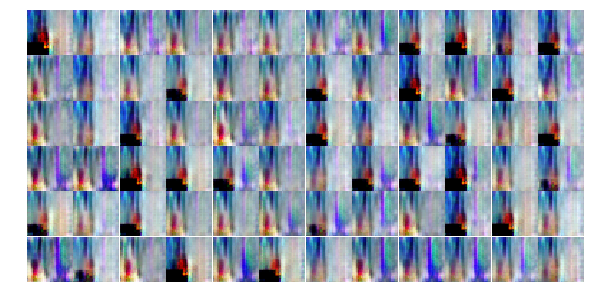

Epoch 7/25... Discriminator Loss: 0.0021... Generator Loss: 7.7608
Epoch 7/25... Discriminator Loss: 0.0006... Generator Loss: 10.9906
Epoch 7/25... Discriminator Loss: 0.0019... Generator Loss: 10.9878
Epoch 7/25... Discriminator Loss: 0.0018... Generator Loss: 12.4143
Epoch 7/25... Discriminator Loss: 0.0011... Generator Loss: 8.6219
Epoch 7/25... Discriminator Loss: 0.0013... Generator Loss: 12.2096
Epoch 7/25... Discriminator Loss: 0.0018... Generator Loss: 8.4618
Epoch 7/25... Discriminator Loss: 0.0023... Generator Loss: 7.7356
Epoch 7/25... Discriminator Loss: 0.0013... Generator Loss: 12.3423
Epoch 7/25... Discriminator Loss: 0.0033... Generator Loss: 7.5924


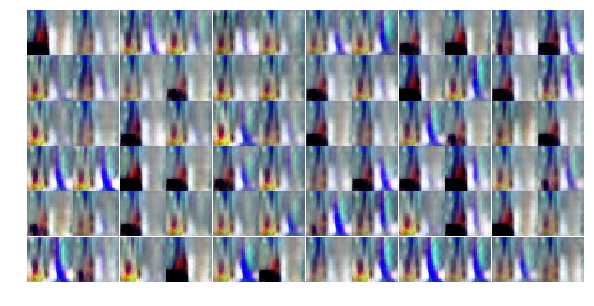

Epoch 7/25... Discriminator Loss: 0.0019... Generator Loss: 10.2687
Epoch 7/25... Discriminator Loss: 0.0036... Generator Loss: 6.2604
Epoch 7/25... Discriminator Loss: 0.0019... Generator Loss: 8.0171
Epoch 7/25... Discriminator Loss: 0.0022... Generator Loss: 7.1702
Epoch 7/25... Discriminator Loss: 0.0044... Generator Loss: 6.7527
Epoch 7/25... Discriminator Loss: 0.0114... Generator Loss: 5.1464
Epoch 7/25... Discriminator Loss: 0.0016... Generator Loss: 10.7003
Epoch 7/25... Discriminator Loss: 0.0006... Generator Loss: 10.8003
Epoch 7/25... Discriminator Loss: 2.0008... Generator Loss: 0.7633
Epoch 7/25... Discriminator Loss: 0.1556... Generator Loss: 2.6742


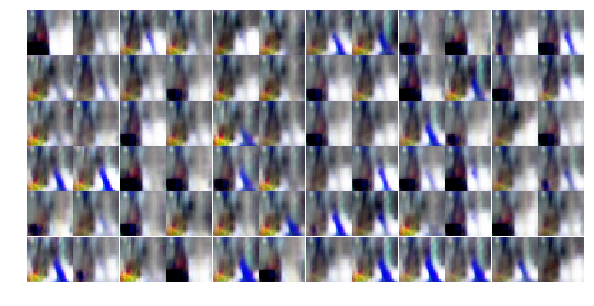

Epoch 7/25... Discriminator Loss: 0.1874... Generator Loss: 2.4687
Epoch 7/25... Discriminator Loss: 0.0293... Generator Loss: 5.3914
Epoch 7/25... Discriminator Loss: 0.0680... Generator Loss: 4.0533
Epoch 7/25... Discriminator Loss: 0.3364... Generator Loss: 5.9518
Epoch 7/25... Discriminator Loss: 0.2393... Generator Loss: 2.1146
Epoch 7/25... Discriminator Loss: 0.0118... Generator Loss: 5.2677
Epoch 7/25... Discriminator Loss: 0.0089... Generator Loss: 6.7638
Epoch 7/25... Discriminator Loss: 0.0514... Generator Loss: 3.7670
Epoch 7/25... Discriminator Loss: 0.0140... Generator Loss: 5.3840
Epoch 7/25... Discriminator Loss: 0.3702... Generator Loss: 1.5907


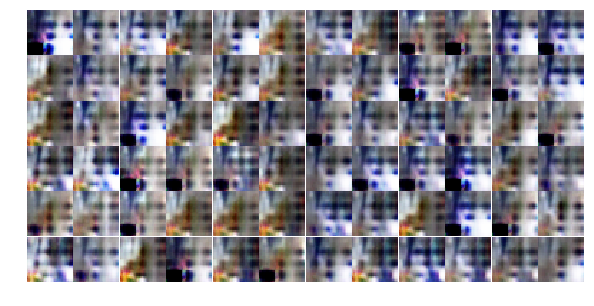

Epoch 7/25... Discriminator Loss: 0.4581... Generator Loss: 1.3979
Epoch 8/25... Discriminator Loss: 0.0894... Generator Loss: 2.9976
Epoch 8/25... Discriminator Loss: 0.1571... Generator Loss: 7.1918
Epoch 8/25... Discriminator Loss: 0.0107... Generator Loss: 9.3249
Epoch 8/25... Discriminator Loss: 0.0074... Generator Loss: 6.2772
Epoch 8/25... Discriminator Loss: 0.0063... Generator Loss: 6.8260
Epoch 8/25... Discriminator Loss: 0.0027... Generator Loss: 7.9917
Epoch 8/25... Discriminator Loss: 0.0058... Generator Loss: 9.2522
Epoch 8/25... Discriminator Loss: 0.0206... Generator Loss: 8.3799
Epoch 8/25... Discriminator Loss: 0.0105... Generator Loss: 8.8976


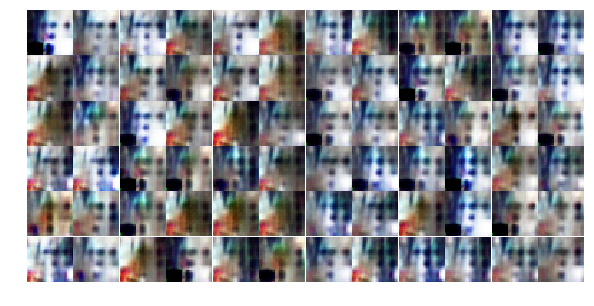

Epoch 8/25... Discriminator Loss: 0.0052... Generator Loss: 8.7578
Epoch 8/25... Discriminator Loss: 0.3117... Generator Loss: 1.9522
Epoch 8/25... Discriminator Loss: 0.0863... Generator Loss: 3.3042
Epoch 8/25... Discriminator Loss: 0.0656... Generator Loss: 5.6723
Epoch 8/25... Discriminator Loss: 0.0421... Generator Loss: 6.3425
Epoch 8/25... Discriminator Loss: 0.0989... Generator Loss: 2.8310
Epoch 8/25... Discriminator Loss: 0.0127... Generator Loss: 9.2616
Epoch 8/25... Discriminator Loss: 0.0058... Generator Loss: 7.8873
Epoch 8/25... Discriminator Loss: 0.0237... Generator Loss: 6.3131
Epoch 8/25... Discriminator Loss: 0.0128... Generator Loss: 6.2380


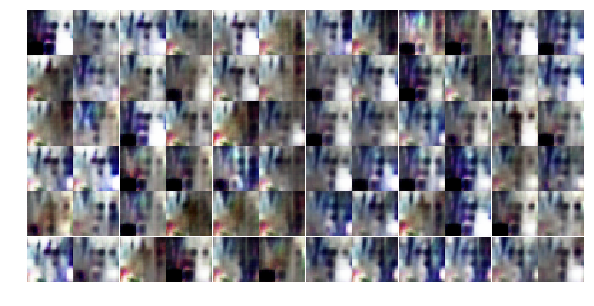

Epoch 8/25... Discriminator Loss: 0.0654... Generator Loss: 3.2786
Epoch 8/25... Discriminator Loss: 0.0135... Generator Loss: 6.5728
Epoch 8/25... Discriminator Loss: 0.0256... Generator Loss: 4.2980
Epoch 8/25... Discriminator Loss: 0.0163... Generator Loss: 9.7578
Epoch 8/25... Discriminator Loss: 0.0121... Generator Loss: 6.1918
Epoch 8/25... Discriminator Loss: 0.0265... Generator Loss: 6.4002
Epoch 8/25... Discriminator Loss: 0.0723... Generator Loss: 3.1272
Epoch 8/25... Discriminator Loss: 0.0142... Generator Loss: 12.0394
Epoch 8/25... Discriminator Loss: 0.0044... Generator Loss: 7.8784
Epoch 8/25... Discriminator Loss: 0.0031... Generator Loss: 9.3841


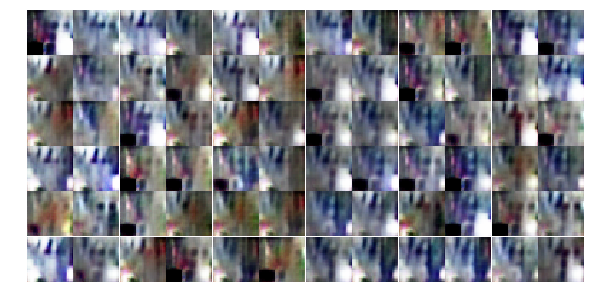

Epoch 8/25... Discriminator Loss: 0.0265... Generator Loss: 4.1711
Epoch 8/25... Discriminator Loss: 0.0053... Generator Loss: 11.1991
Epoch 8/25... Discriminator Loss: 0.0089... Generator Loss: 6.5851
Epoch 8/25... Discriminator Loss: 0.0033... Generator Loss: 6.9880
Epoch 8/25... Discriminator Loss: 0.0089... Generator Loss: 10.1792
Epoch 8/25... Discriminator Loss: 0.0088... Generator Loss: 7.6293
Epoch 8/25... Discriminator Loss: 0.0035... Generator Loss: 10.8931
Epoch 8/25... Discriminator Loss: 0.0098... Generator Loss: 11.6381
Epoch 8/25... Discriminator Loss: 0.0047... Generator Loss: 7.5543
Epoch 8/25... Discriminator Loss: 0.1877... Generator Loss: 9.9051


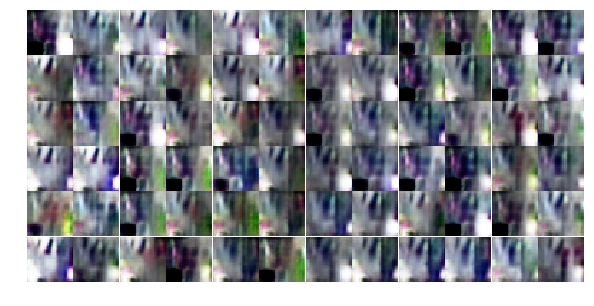

Epoch 8/25... Discriminator Loss: 0.0103... Generator Loss: 5.4618
Epoch 8/25... Discriminator Loss: 0.0249... Generator Loss: 4.4829
Epoch 8/25... Discriminator Loss: 0.0248... Generator Loss: 9.3111
Epoch 8/25... Discriminator Loss: 0.0105... Generator Loss: 5.6230
Epoch 8/25... Discriminator Loss: 0.0039... Generator Loss: 11.0001
Epoch 8/25... Discriminator Loss: 0.0934... Generator Loss: 11.9138
Epoch 8/25... Discriminator Loss: 0.0102... Generator Loss: 9.9699
Epoch 8/25... Discriminator Loss: 0.8578... Generator Loss: 0.7566
Epoch 8/25... Discriminator Loss: 0.0260... Generator Loss: 5.5676
Epoch 8/25... Discriminator Loss: 0.0564... Generator Loss: 6.0045


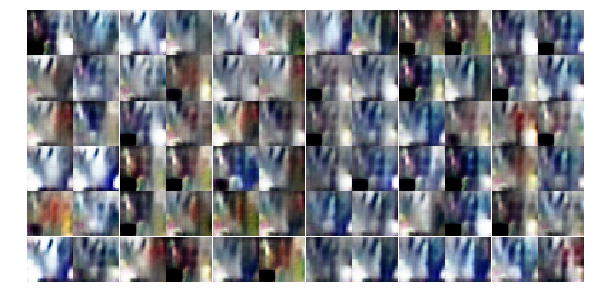

Epoch 8/25... Discriminator Loss: 0.0126... Generator Loss: 12.1937
Epoch 8/25... Discriminator Loss: 0.0020... Generator Loss: 10.3309
Epoch 8/25... Discriminator Loss: 0.0055... Generator Loss: 7.5353
Epoch 8/25... Discriminator Loss: 0.0070... Generator Loss: 11.9906
Epoch 8/25... Discriminator Loss: 0.0036... Generator Loss: 7.0524
Epoch 8/25... Discriminator Loss: 0.0062... Generator Loss: 11.9373
Epoch 8/25... Discriminator Loss: 0.0025... Generator Loss: 7.6555
Epoch 8/25... Discriminator Loss: 0.0039... Generator Loss: 10.1457
Epoch 9/25... Discriminator Loss: 0.0044... Generator Loss: 7.2751
Epoch 9/25... Discriminator Loss: 0.0023... Generator Loss: 7.5116


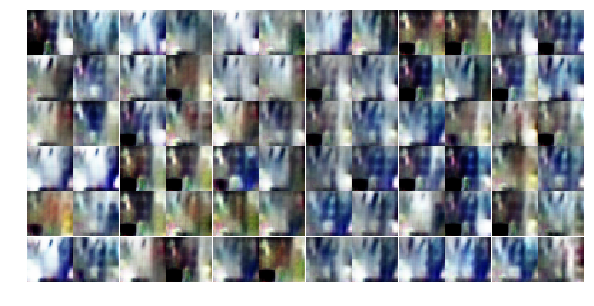

Epoch 9/25... Discriminator Loss: 0.0075... Generator Loss: 5.5241
Epoch 9/25... Discriminator Loss: 0.0031... Generator Loss: 10.6449
Epoch 9/25... Discriminator Loss: 0.3440... Generator Loss: 1.5322
Epoch 9/25... Discriminator Loss: 0.0005... Generator Loss: 11.4363
Epoch 9/25... Discriminator Loss: 0.0004... Generator Loss: 10.9743
Epoch 9/25... Discriminator Loss: 0.0006... Generator Loss: 10.7015
Epoch 9/25... Discriminator Loss: 0.0008... Generator Loss: 9.4569
Epoch 9/25... Discriminator Loss: 0.0097... Generator Loss: 5.2050
Epoch 9/25... Discriminator Loss: 0.0133... Generator Loss: 11.1516
Epoch 9/25... Discriminator Loss: 0.1674... Generator Loss: 2.2936


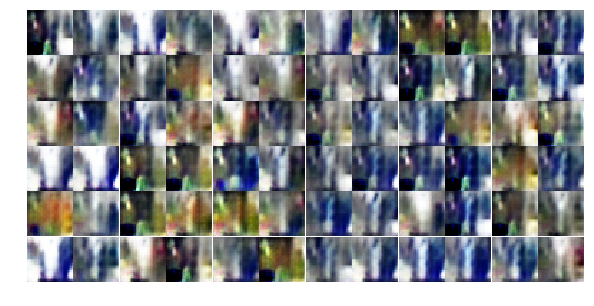

Epoch 9/25... Discriminator Loss: 0.0161... Generator Loss: 13.1756
Epoch 9/25... Discriminator Loss: 0.0034... Generator Loss: 11.4478
Epoch 9/25... Discriminator Loss: 0.0006... Generator Loss: 9.9174
Epoch 9/25... Discriminator Loss: 0.0010... Generator Loss: 9.5215
Epoch 9/25... Discriminator Loss: 0.0020... Generator Loss: 9.1934
Epoch 9/25... Discriminator Loss: 0.0020... Generator Loss: 8.9344
Epoch 9/25... Discriminator Loss: 0.0008... Generator Loss: 8.8223
Epoch 9/25... Discriminator Loss: 0.0006... Generator Loss: 8.7418
Epoch 9/25... Discriminator Loss: 0.0006... Generator Loss: 8.6500
Epoch 9/25... Discriminator Loss: 0.0006... Generator Loss: 8.5901


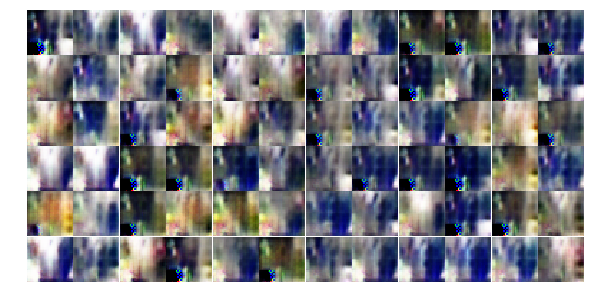

Epoch 9/25... Discriminator Loss: 0.0006... Generator Loss: 8.5085
Epoch 9/25... Discriminator Loss: 0.0007... Generator Loss: 8.4202
Epoch 9/25... Discriminator Loss: 0.0009... Generator Loss: 8.2922
Epoch 9/25... Discriminator Loss: 0.0013... Generator Loss: 8.1808
Epoch 9/25... Discriminator Loss: 0.0016... Generator Loss: 7.5715
Epoch 9/25... Discriminator Loss: 0.0007... Generator Loss: 9.6261
Epoch 9/25... Discriminator Loss: 0.0408... Generator Loss: 3.6314
Epoch 9/25... Discriminator Loss: 0.0019... Generator Loss: 10.7327
Epoch 9/25... Discriminator Loss: 0.0019... Generator Loss: 8.1429
Epoch 9/25... Discriminator Loss: 0.0059... Generator Loss: 5.7355


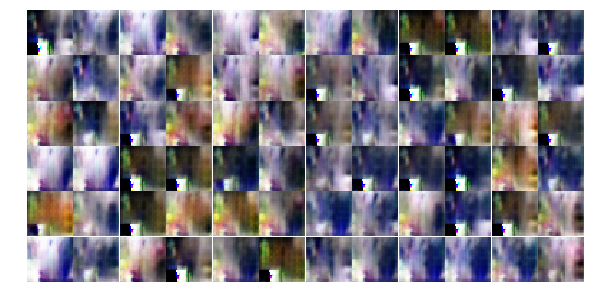

Epoch 9/25... Discriminator Loss: 0.0018... Generator Loss: 7.5008
Epoch 9/25... Discriminator Loss: 0.0051... Generator Loss: 11.1426
Epoch 9/25... Discriminator Loss: 0.0014... Generator Loss: 9.4833
Epoch 9/25... Discriminator Loss: 0.0024... Generator Loss: 7.4249
Epoch 9/25... Discriminator Loss: 0.0018... Generator Loss: 10.6742
Epoch 9/25... Discriminator Loss: 0.0008... Generator Loss: 12.4977
Epoch 9/25... Discriminator Loss: 0.0006... Generator Loss: 9.8721
Epoch 9/25... Discriminator Loss: 0.0067... Generator Loss: 10.8225
Epoch 9/25... Discriminator Loss: 0.1682... Generator Loss: 2.2940
Epoch 9/25... Discriminator Loss: 0.0018... Generator Loss: 12.7931


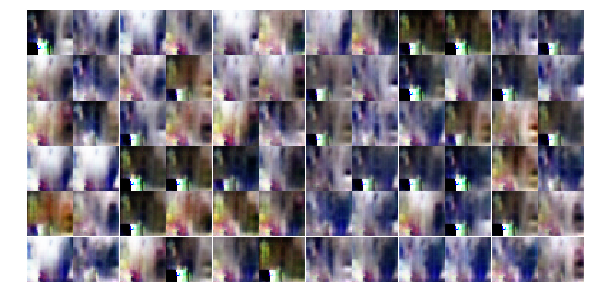

Epoch 9/25... Discriminator Loss: 0.0024... Generator Loss: 7.8460
Epoch 9/25... Discriminator Loss: 0.0024... Generator Loss: 6.9712
Epoch 9/25... Discriminator Loss: 0.0010... Generator Loss: 12.0174
Epoch 9/25... Discriminator Loss: 0.0016... Generator Loss: 7.5949
Epoch 9/25... Discriminator Loss: 0.0158... Generator Loss: 4.9947
Epoch 9/25... Discriminator Loss: 0.0013... Generator Loss: 13.0498
Epoch 9/25... Discriminator Loss: 0.0072... Generator Loss: 6.1671
Epoch 9/25... Discriminator Loss: 0.0019... Generator Loss: 9.1510
Epoch 9/25... Discriminator Loss: 0.0038... Generator Loss: 12.6812
Epoch 9/25... Discriminator Loss: 0.0008... Generator Loss: 11.4090


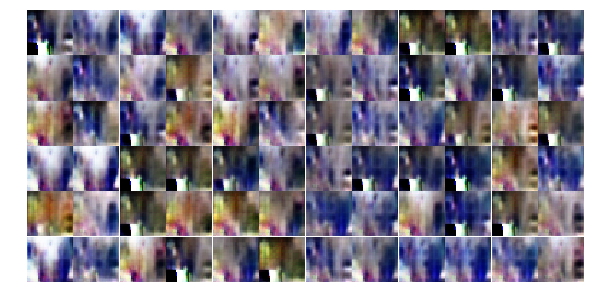

Epoch 9/25... Discriminator Loss: 0.0008... Generator Loss: 8.2781
Epoch 9/25... Discriminator Loss: 0.0023... Generator Loss: 7.1843
Epoch 9/25... Discriminator Loss: 0.0144... Generator Loss: 13.3988
Epoch 9/25... Discriminator Loss: 0.0025... Generator Loss: 11.8050
Epoch 9/25... Discriminator Loss: 0.0010... Generator Loss: 8.7772
Epoch 10/25... Discriminator Loss: 0.0015... Generator Loss: 7.8469
Epoch 10/25... Discriminator Loss: 0.0658... Generator Loss: 3.1799
Epoch 10/25... Discriminator Loss: 0.0013... Generator Loss: 12.2729
Epoch 10/25... Discriminator Loss: 0.0063... Generator Loss: 5.8846
Epoch 10/25... Discriminator Loss: 0.0071... Generator Loss: 8.9277


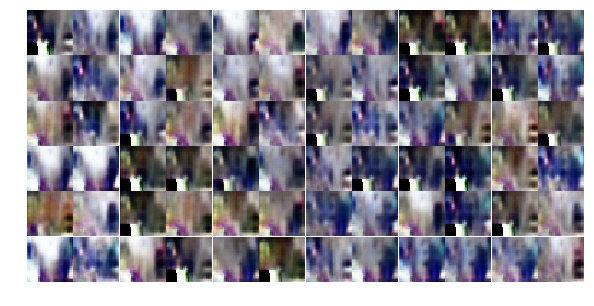

Epoch 10/25... Discriminator Loss: 0.0042... Generator Loss: 6.4033
Epoch 10/25... Discriminator Loss: 0.0042... Generator Loss: 13.2993
Epoch 10/25... Discriminator Loss: 0.0012... Generator Loss: 12.2201
Epoch 10/25... Discriminator Loss: 0.0011... Generator Loss: 11.1577
Epoch 10/25... Discriminator Loss: 0.0009... Generator Loss: 9.4841
Epoch 10/25... Discriminator Loss: 0.0010... Generator Loss: 11.1871
Epoch 10/25... Discriminator Loss: 0.0012... Generator Loss: 12.3019
Epoch 10/25... Discriminator Loss: 0.0029... Generator Loss: 7.0360
Epoch 10/25... Discriminator Loss: 0.0062... Generator Loss: 12.8455
Epoch 10/25... Discriminator Loss: 0.0006... Generator Loss: 11.8668


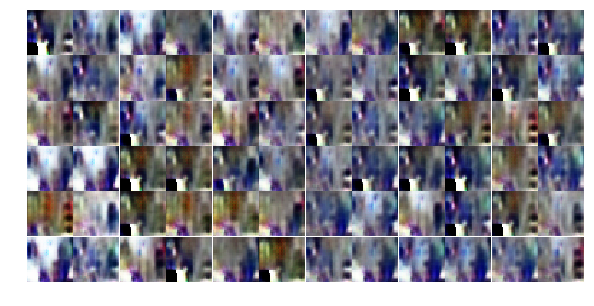

Epoch 10/25... Discriminator Loss: 0.0006... Generator Loss: 10.6886
Epoch 10/25... Discriminator Loss: 0.0100... Generator Loss: 5.5205
Epoch 10/25... Discriminator Loss: 0.0125... Generator Loss: 5.0066
Epoch 10/25... Discriminator Loss: 0.0055... Generator Loss: 9.8800
Epoch 10/25... Discriminator Loss: 0.0019... Generator Loss: 7.2017
Epoch 10/25... Discriminator Loss: 0.0049... Generator Loss: 10.5302
Epoch 10/25... Discriminator Loss: 0.0004... Generator Loss: 11.8881
Epoch 10/25... Discriminator Loss: 0.0027... Generator Loss: 12.5539
Epoch 10/25... Discriminator Loss: 0.0008... Generator Loss: 9.7535
Epoch 10/25... Discriminator Loss: 0.0025... Generator Loss: 10.1296


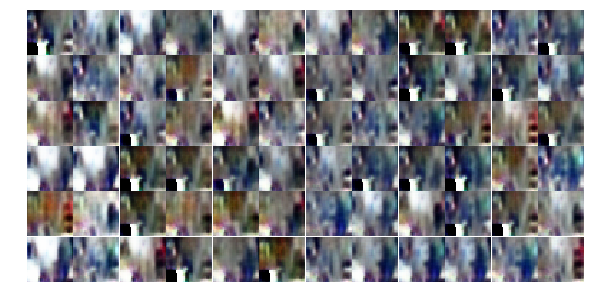

Epoch 10/25... Discriminator Loss: 0.0100... Generator Loss: 5.2625
Epoch 10/25... Discriminator Loss: 0.0051... Generator Loss: 12.3044
Epoch 10/25... Discriminator Loss: 0.0074... Generator Loss: 6.5939
Epoch 10/25... Discriminator Loss: 0.0008... Generator Loss: 13.6283
Epoch 10/25... Discriminator Loss: 0.0008... Generator Loss: 9.9123
Epoch 10/25... Discriminator Loss: 0.0016... Generator Loss: 12.6761
Epoch 10/25... Discriminator Loss: 0.0014... Generator Loss: 10.2210
Epoch 10/25... Discriminator Loss: 0.0038... Generator Loss: 7.3671
Epoch 10/25... Discriminator Loss: 0.0006... Generator Loss: 10.6045
Epoch 10/25... Discriminator Loss: 0.0003... Generator Loss: 12.0217


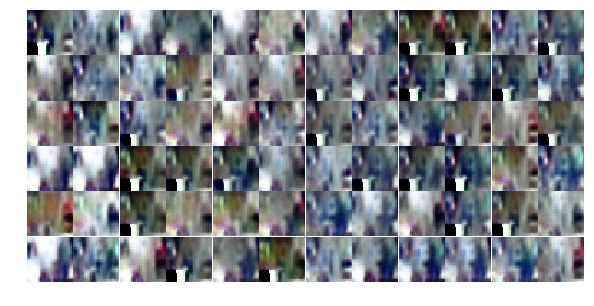

Epoch 10/25... Discriminator Loss: 0.0177... Generator Loss: 8.4664
Epoch 10/25... Discriminator Loss: 0.0016... Generator Loss: 12.3340
Epoch 10/25... Discriminator Loss: 0.0022... Generator Loss: 13.4967
Epoch 10/25... Discriminator Loss: 0.0121... Generator Loss: 5.1854
Epoch 10/25... Discriminator Loss: 0.0080... Generator Loss: 13.6454
Epoch 10/25... Discriminator Loss: 0.0003... Generator Loss: 10.1811
Epoch 10/25... Discriminator Loss: 0.0038... Generator Loss: 7.1780
Epoch 10/25... Discriminator Loss: 0.0007... Generator Loss: 10.2415
Epoch 10/25... Discriminator Loss: 0.0037... Generator Loss: 13.1500
Epoch 10/25... Discriminator Loss: 0.0017... Generator Loss: 11.5323


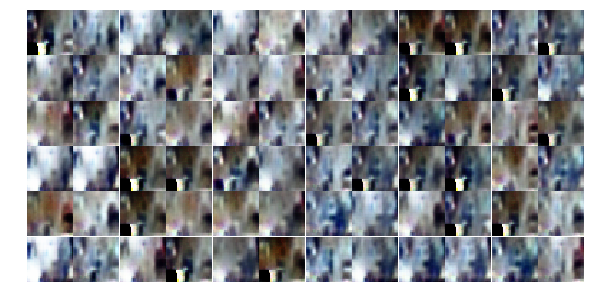

Epoch 10/25... Discriminator Loss: 0.0011... Generator Loss: 10.6882
Epoch 10/25... Discriminator Loss: 0.0023... Generator Loss: 7.4641
Epoch 10/25... Discriminator Loss: 0.0007... Generator Loss: 10.8827
Epoch 10/25... Discriminator Loss: 0.0019... Generator Loss: 10.5718
Epoch 10/25... Discriminator Loss: 0.0008... Generator Loss: 13.1884
Epoch 10/25... Discriminator Loss: 0.0011... Generator Loss: 11.5068
Epoch 10/25... Discriminator Loss: 0.0050... Generator Loss: 6.0681
Epoch 10/25... Discriminator Loss: 0.0014... Generator Loss: 8.1932
Epoch 10/25... Discriminator Loss: 0.0010... Generator Loss: 14.1738
Epoch 10/25... Discriminator Loss: 0.0031... Generator Loss: 13.2436


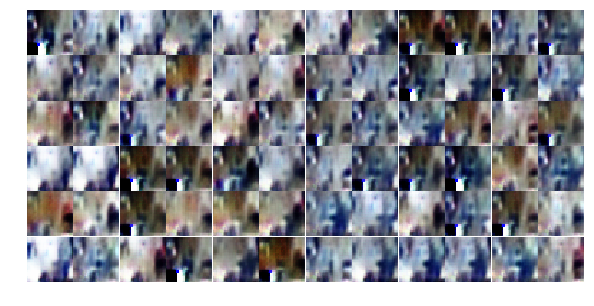

Epoch 10/25... Discriminator Loss: 0.0011... Generator Loss: 7.8043
Epoch 10/25... Discriminator Loss: 0.0080... Generator Loss: 11.6163
Epoch 10/25... Discriminator Loss: 0.0017... Generator Loss: 13.3730
Epoch 11/25... Discriminator Loss: 0.0030... Generator Loss: 6.3069
Epoch 11/25... Discriminator Loss: 1.2140... Generator Loss: 1.4143
Epoch 11/25... Discriminator Loss: 0.5361... Generator Loss: 1.7755
Epoch 11/25... Discriminator Loss: 0.2619... Generator Loss: 2.6622
Epoch 11/25... Discriminator Loss: 0.3450... Generator Loss: 1.8002
Epoch 11/25... Discriminator Loss: 0.9897... Generator Loss: 0.7806
Epoch 11/25... Discriminator Loss: 0.1221... Generator Loss: 2.7750


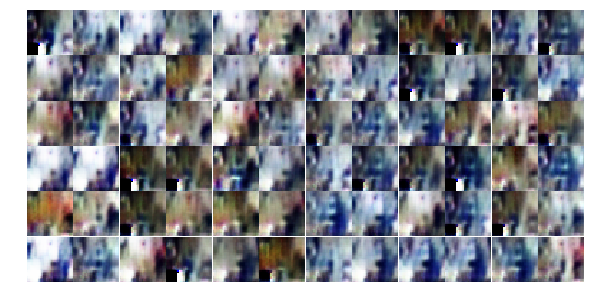

Epoch 11/25... Discriminator Loss: 0.1136... Generator Loss: 2.8342
Epoch 11/25... Discriminator Loss: 0.0579... Generator Loss: 3.7782
Epoch 11/25... Discriminator Loss: 0.0576... Generator Loss: 5.2106
Epoch 11/25... Discriminator Loss: 0.0168... Generator Loss: 5.7622
Epoch 11/25... Discriminator Loss: 2.3311... Generator Loss: 5.7470
Epoch 11/25... Discriminator Loss: 0.5363... Generator Loss: 1.4733
Epoch 11/25... Discriminator Loss: 0.2642... Generator Loss: 1.8119
Epoch 11/25... Discriminator Loss: 0.9934... Generator Loss: 0.6706
Epoch 11/25... Discriminator Loss: 0.0779... Generator Loss: 3.4622
Epoch 11/25... Discriminator Loss: 0.0387... Generator Loss: 4.2108


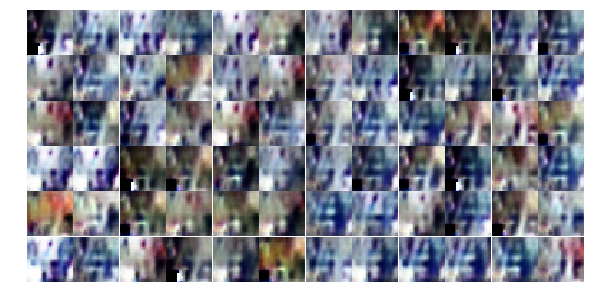

Epoch 11/25... Discriminator Loss: 0.0485... Generator Loss: 3.8928
Epoch 11/25... Discriminator Loss: 0.1640... Generator Loss: 2.2996
Epoch 11/25... Discriminator Loss: 0.0554... Generator Loss: 5.9609
Epoch 11/25... Discriminator Loss: 1.6255... Generator Loss: 0.2950
Epoch 11/25... Discriminator Loss: 0.2518... Generator Loss: 2.9857
Epoch 11/25... Discriminator Loss: 1.1845... Generator Loss: 0.4815
Epoch 11/25... Discriminator Loss: 0.0943... Generator Loss: 5.0454
Epoch 11/25... Discriminator Loss: 0.7750... Generator Loss: 0.7710
Epoch 11/25... Discriminator Loss: 0.0262... Generator Loss: 5.2628
Epoch 11/25... Discriminator Loss: 0.2056... Generator Loss: 2.0366


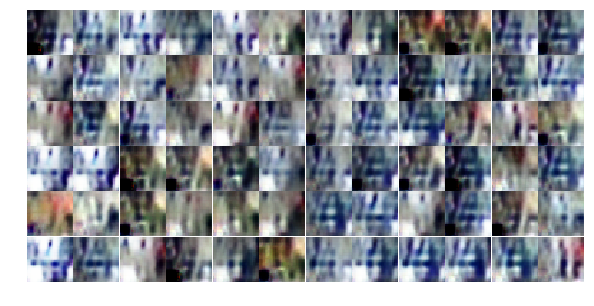

Epoch 11/25... Discriminator Loss: 0.0233... Generator Loss: 5.4765
Epoch 11/25... Discriminator Loss: 0.3676... Generator Loss: 1.3547
Epoch 11/25... Discriminator Loss: 0.4760... Generator Loss: 1.1494
Epoch 11/25... Discriminator Loss: 0.2839... Generator Loss: 10.1382
Epoch 11/25... Discriminator Loss: 0.0037... Generator Loss: 7.8540
Epoch 11/25... Discriminator Loss: 0.0375... Generator Loss: 6.1189
Epoch 11/25... Discriminator Loss: 0.1089... Generator Loss: 8.5690
Epoch 11/25... Discriminator Loss: 0.0103... Generator Loss: 8.7788
Epoch 11/25... Discriminator Loss: 0.0363... Generator Loss: 9.1417
Epoch 11/25... Discriminator Loss: 0.0067... Generator Loss: 8.4011


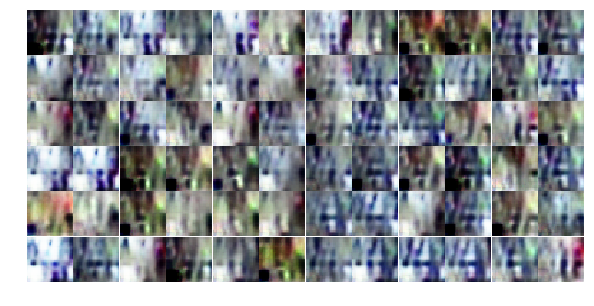

Epoch 11/25... Discriminator Loss: 0.1264... Generator Loss: 2.5237
Epoch 11/25... Discriminator Loss: 0.0093... Generator Loss: 8.9390
Epoch 11/25... Discriminator Loss: 0.0462... Generator Loss: 11.4314
Epoch 11/25... Discriminator Loss: 0.0038... Generator Loss: 9.8054
Epoch 11/25... Discriminator Loss: 0.0467... Generator Loss: 5.7097
Epoch 11/25... Discriminator Loss: 0.0427... Generator Loss: 11.3789
Epoch 11/25... Discriminator Loss: 0.0054... Generator Loss: 6.7579
Epoch 11/25... Discriminator Loss: 0.0711... Generator Loss: 3.2930
Epoch 11/25... Discriminator Loss: 0.0127... Generator Loss: 7.1382
Epoch 11/25... Discriminator Loss: 0.0447... Generator Loss: 4.0483


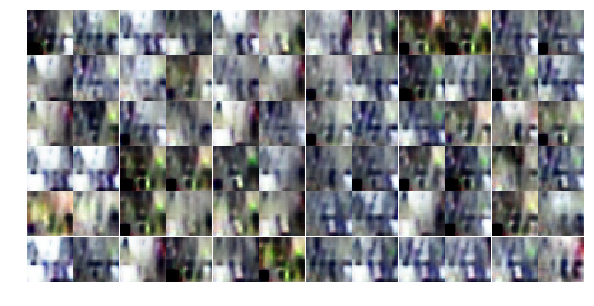

Epoch 11/25... Discriminator Loss: 0.0165... Generator Loss: 11.7074
Epoch 11/25... Discriminator Loss: 0.0065... Generator Loss: 9.7125
Epoch 11/25... Discriminator Loss: 0.0232... Generator Loss: 4.6718
Epoch 11/25... Discriminator Loss: 0.0047... Generator Loss: 8.5674
Epoch 11/25... Discriminator Loss: 0.0043... Generator Loss: 8.3177
Epoch 11/25... Discriminator Loss: 0.0052... Generator Loss: 8.4684
Epoch 11/25... Discriminator Loss: 0.0150... Generator Loss: 9.9711
Epoch 11/25... Discriminator Loss: 0.0024... Generator Loss: 9.0461
Epoch 11/25... Discriminator Loss: 0.0182... Generator Loss: 7.6253
Epoch 11/25... Discriminator Loss: 0.0036... Generator Loss: 6.9017


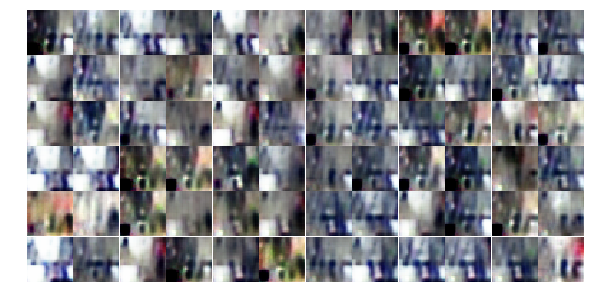

Epoch 12/25... Discriminator Loss: 0.0335... Generator Loss: 4.7522
Epoch 12/25... Discriminator Loss: 0.3554... Generator Loss: 1.5196
Epoch 12/25... Discriminator Loss: 0.0144... Generator Loss: 10.3821
Epoch 12/25... Discriminator Loss: 0.0654... Generator Loss: 3.1750
Epoch 12/25... Discriminator Loss: 0.0136... Generator Loss: 10.7650
Epoch 12/25... Discriminator Loss: 0.0439... Generator Loss: 3.8129
Epoch 12/25... Discriminator Loss: 0.0176... Generator Loss: 9.0814
Epoch 12/25... Discriminator Loss: 0.0165... Generator Loss: 6.6636
Epoch 12/25... Discriminator Loss: 0.0209... Generator Loss: 10.4201
Epoch 12/25... Discriminator Loss: 0.0233... Generator Loss: 9.7153


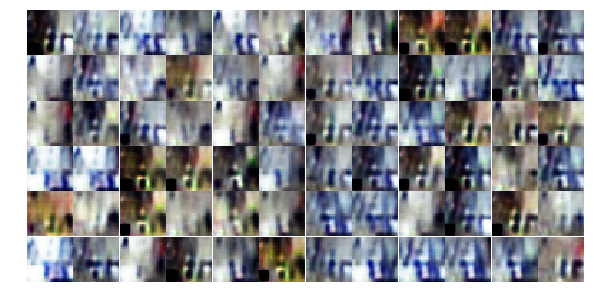

Epoch 12/25... Discriminator Loss: 0.0053... Generator Loss: 12.3627
Epoch 12/25... Discriminator Loss: 0.0010... Generator Loss: 11.2196
Epoch 12/25... Discriminator Loss: 0.0025... Generator Loss: 10.0689
Epoch 12/25... Discriminator Loss: 0.1044... Generator Loss: 2.6790
Epoch 12/25... Discriminator Loss: 0.0069... Generator Loss: 12.0607
Epoch 12/25... Discriminator Loss: 0.0305... Generator Loss: 3.8793
Epoch 12/25... Discriminator Loss: 0.0040... Generator Loss: 9.8836
Epoch 12/25... Discriminator Loss: 0.0039... Generator Loss: 9.8729
Epoch 12/25... Discriminator Loss: 0.0274... Generator Loss: 4.9658
Epoch 12/25... Discriminator Loss: 0.0051... Generator Loss: 10.4277


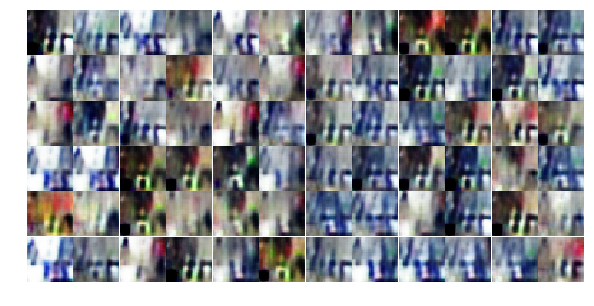

Epoch 12/25... Discriminator Loss: 0.0223... Generator Loss: 8.7452
Epoch 12/25... Discriminator Loss: 0.0108... Generator Loss: 6.4474
Epoch 12/25... Discriminator Loss: 0.1794... Generator Loss: 12.5758
Epoch 12/25... Discriminator Loss: 0.0069... Generator Loss: 10.4277
Epoch 12/25... Discriminator Loss: 0.0348... Generator Loss: 9.4662
Epoch 12/25... Discriminator Loss: 0.0029... Generator Loss: 12.2796
Epoch 12/25... Discriminator Loss: 0.0011... Generator Loss: 11.5660
Epoch 12/25... Discriminator Loss: 0.4098... Generator Loss: 1.3779
Epoch 12/25... Discriminator Loss: 0.0094... Generator Loss: 12.1280
Epoch 12/25... Discriminator Loss: 0.0038... Generator Loss: 11.2955


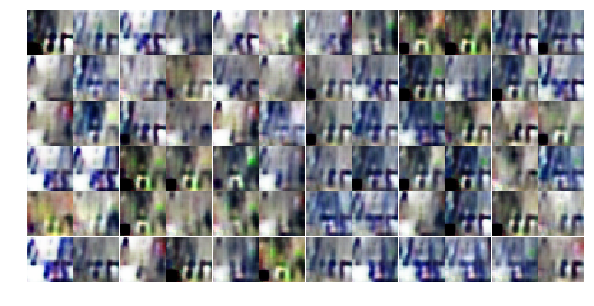

Epoch 12/25... Discriminator Loss: 0.0064... Generator Loss: 11.5651
Epoch 12/25... Discriminator Loss: 0.0309... Generator Loss: 3.9403
Epoch 12/25... Discriminator Loss: 0.0304... Generator Loss: 8.9151
Epoch 12/25... Discriminator Loss: 0.0052... Generator Loss: 6.4795
Epoch 12/25... Discriminator Loss: 0.0162... Generator Loss: 4.8179
Epoch 12/25... Discriminator Loss: 0.0087... Generator Loss: 12.7394
Epoch 12/25... Discriminator Loss: 0.0047... Generator Loss: 8.7890
Epoch 12/25... Discriminator Loss: 0.0044... Generator Loss: 12.7442
Epoch 12/25... Discriminator Loss: 0.0016... Generator Loss: 11.2194
Epoch 12/25... Discriminator Loss: 0.0305... Generator Loss: 8.1979


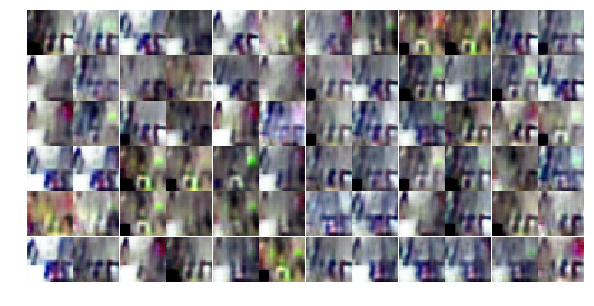

Epoch 12/25... Discriminator Loss: 0.0018... Generator Loss: 12.6389
Epoch 12/25... Discriminator Loss: 0.0034... Generator Loss: 10.5382
Epoch 12/25... Discriminator Loss: 0.0240... Generator Loss: 4.5491
Epoch 12/25... Discriminator Loss: 0.0020... Generator Loss: 11.8610
Epoch 12/25... Discriminator Loss: 0.0304... Generator Loss: 4.0210
Epoch 12/25... Discriminator Loss: 0.0019... Generator Loss: 8.6028
Epoch 12/25... Discriminator Loss: 0.0112... Generator Loss: 5.4348
Epoch 12/25... Discriminator Loss: 0.0048... Generator Loss: 9.1495
Epoch 12/25... Discriminator Loss: 0.3680... Generator Loss: 1.4952
Epoch 12/25... Discriminator Loss: 0.0010... Generator Loss: 13.1405


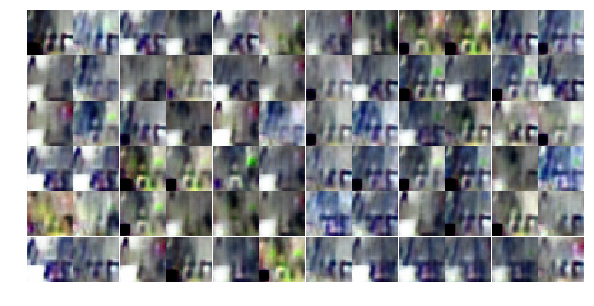

Epoch 12/25... Discriminator Loss: 0.0015... Generator Loss: 10.1247
Epoch 12/25... Discriminator Loss: 0.0207... Generator Loss: 9.8940
Epoch 12/25... Discriminator Loss: 0.0061... Generator Loss: 11.0377
Epoch 12/25... Discriminator Loss: 0.0039... Generator Loss: 12.5112
Epoch 12/25... Discriminator Loss: 0.0059... Generator Loss: 13.5287
Epoch 12/25... Discriminator Loss: 0.0030... Generator Loss: 13.0325
Epoch 12/25... Discriminator Loss: 0.0011... Generator Loss: 12.4976
Epoch 13/25... Discriminator Loss: 0.1527... Generator Loss: 2.4067
Epoch 13/25... Discriminator Loss: 0.0073... Generator Loss: 10.9882
Epoch 13/25... Discriminator Loss: 0.0017... Generator Loss: 10.3049


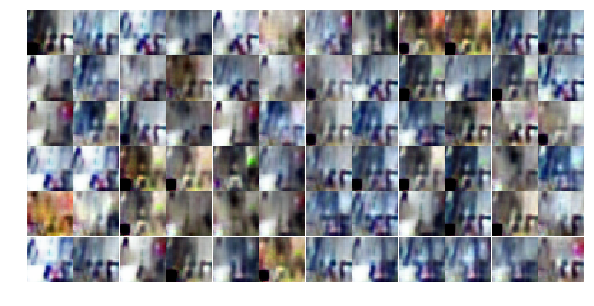

Epoch 13/25... Discriminator Loss: 0.0007... Generator Loss: 11.0073
Epoch 13/25... Discriminator Loss: 0.0019... Generator Loss: 13.6296
Epoch 13/25... Discriminator Loss: 0.0019... Generator Loss: 12.6148
Epoch 13/25... Discriminator Loss: 0.0004... Generator Loss: 10.7000
Epoch 13/25... Discriminator Loss: 0.0087... Generator Loss: 6.7417
Epoch 13/25... Discriminator Loss: 0.1254... Generator Loss: 2.5344
Epoch 13/25... Discriminator Loss: 0.0031... Generator Loss: 12.7653
Epoch 13/25... Discriminator Loss: 0.0007... Generator Loss: 11.8717
Epoch 13/25... Discriminator Loss: 0.0008... Generator Loss: 10.7078
Epoch 13/25... Discriminator Loss: 0.0010... Generator Loss: 11.0010


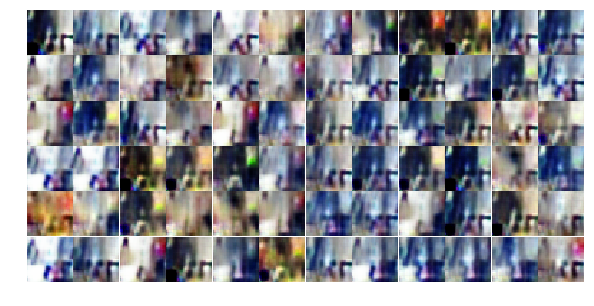

Epoch 13/25... Discriminator Loss: 0.0004... Generator Loss: 12.1593
Epoch 13/25... Discriminator Loss: 0.0028... Generator Loss: 12.6463
Epoch 13/25... Discriminator Loss: 0.0009... Generator Loss: 10.4206
Epoch 13/25... Discriminator Loss: 0.0092... Generator Loss: 12.2737
Epoch 13/25... Discriminator Loss: 0.0007... Generator Loss: 11.5397
Epoch 13/25... Discriminator Loss: 0.0029... Generator Loss: 8.4435
Epoch 13/25... Discriminator Loss: 0.0472... Generator Loss: 8.7036
Epoch 13/25... Discriminator Loss: 0.1456... Generator Loss: 4.7516
Epoch 13/25... Discriminator Loss: 0.0383... Generator Loss: 7.0972
Epoch 13/25... Discriminator Loss: 0.1120... Generator Loss: 9.6620


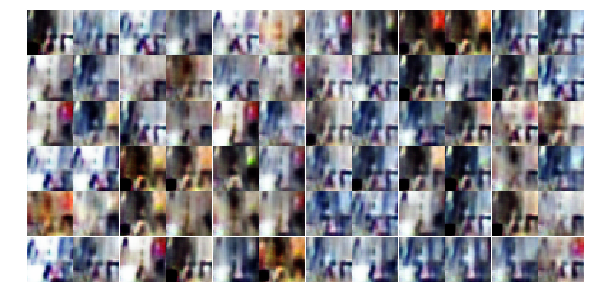

Epoch 13/25... Discriminator Loss: 0.0092... Generator Loss: 6.6141
Epoch 13/25... Discriminator Loss: 0.0530... Generator Loss: 7.7798
Epoch 13/25... Discriminator Loss: 0.1343... Generator Loss: 2.9957
Epoch 13/25... Discriminator Loss: 0.0116... Generator Loss: 8.3559
Epoch 13/25... Discriminator Loss: 0.0287... Generator Loss: 4.2481
Epoch 13/25... Discriminator Loss: 0.0356... Generator Loss: 5.6591
Epoch 13/25... Discriminator Loss: 0.0151... Generator Loss: 5.3013
Epoch 13/25... Discriminator Loss: 0.0352... Generator Loss: 9.0308
Epoch 13/25... Discriminator Loss: 0.0046... Generator Loss: 9.8465
Epoch 13/25... Discriminator Loss: 0.0590... Generator Loss: 9.5876


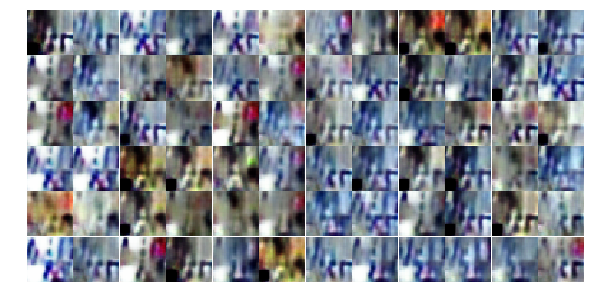

Epoch 13/25... Discriminator Loss: 0.0538... Generator Loss: 9.7466
Epoch 13/25... Discriminator Loss: 0.0187... Generator Loss: 8.3719
Epoch 13/25... Discriminator Loss: 0.0149... Generator Loss: 6.3850
Epoch 13/25... Discriminator Loss: 0.1205... Generator Loss: 2.4012
Epoch 13/25... Discriminator Loss: 0.0135... Generator Loss: 9.2640
Epoch 13/25... Discriminator Loss: 0.0069... Generator Loss: 8.9485
Epoch 13/25... Discriminator Loss: 0.0166... Generator Loss: 11.6958
Epoch 13/25... Discriminator Loss: 0.7711... Generator Loss: 0.7857
Epoch 13/25... Discriminator Loss: 0.5749... Generator Loss: 6.0212
Epoch 13/25... Discriminator Loss: 0.1042... Generator Loss: 3.8243


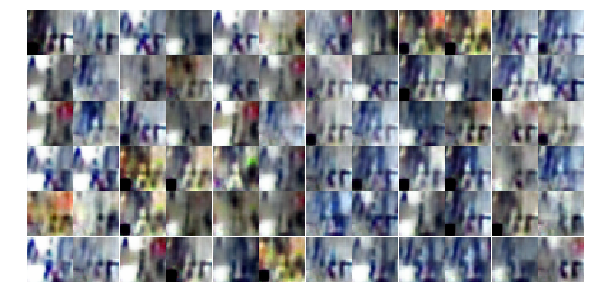

Epoch 13/25... Discriminator Loss: 0.0145... Generator Loss: 12.7010
Epoch 13/25... Discriminator Loss: 0.0019... Generator Loss: 11.7760
Epoch 13/25... Discriminator Loss: 0.0032... Generator Loss: 7.7076
Epoch 13/25... Discriminator Loss: 0.0084... Generator Loss: 6.9078
Epoch 13/25... Discriminator Loss: 0.0163... Generator Loss: 4.5881
Epoch 13/25... Discriminator Loss: 0.0039... Generator Loss: 12.2550
Epoch 13/25... Discriminator Loss: 0.0308... Generator Loss: 3.9412
Epoch 13/25... Discriminator Loss: 0.0014... Generator Loss: 9.7733
Epoch 13/25... Discriminator Loss: 0.0040... Generator Loss: 10.9503
Epoch 13/25... Discriminator Loss: 0.0033... Generator Loss: 8.7925


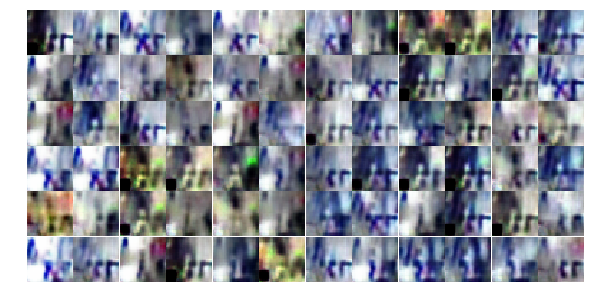

Epoch 13/25... Discriminator Loss: 0.0036... Generator Loss: 10.1459
Epoch 13/25... Discriminator Loss: 0.0020... Generator Loss: 11.7391
Epoch 13/25... Discriminator Loss: 0.0256... Generator Loss: 11.6956
Epoch 13/25... Discriminator Loss: 0.0279... Generator Loss: 12.0991
Epoch 14/25... Discriminator Loss: 0.0139... Generator Loss: 10.9256
Epoch 14/25... Discriminator Loss: 0.0382... Generator Loss: 4.0914
Epoch 14/25... Discriminator Loss: 0.0175... Generator Loss: 10.9212
Epoch 14/25... Discriminator Loss: 0.0030... Generator Loss: 11.6991
Epoch 14/25... Discriminator Loss: 0.0411... Generator Loss: 11.9295
Epoch 14/25... Discriminator Loss: 0.0613... Generator Loss: 3.2147


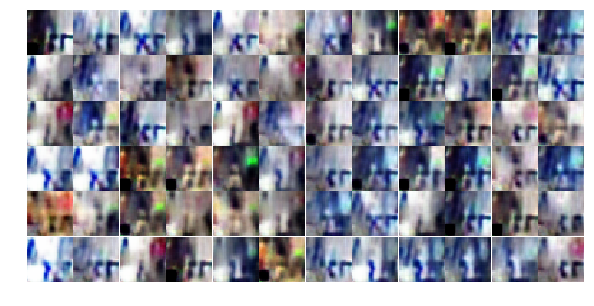

Epoch 14/25... Discriminator Loss: 0.0037... Generator Loss: 12.2903
Epoch 14/25... Discriminator Loss: 0.0061... Generator Loss: 8.5283
Epoch 14/25... Discriminator Loss: 0.0086... Generator Loss: 11.2396
Epoch 14/25... Discriminator Loss: 0.0042... Generator Loss: 8.5542
Epoch 14/25... Discriminator Loss: 0.0040... Generator Loss: 6.8935
Epoch 14/25... Discriminator Loss: 0.0090... Generator Loss: 12.8401
Epoch 14/25... Discriminator Loss: 0.0011... Generator Loss: 12.1979
Epoch 14/25... Discriminator Loss: 0.0264... Generator Loss: 4.1918
Epoch 14/25... Discriminator Loss: 0.0019... Generator Loss: 8.1504
Epoch 14/25... Discriminator Loss: 0.0397... Generator Loss: 11.4149


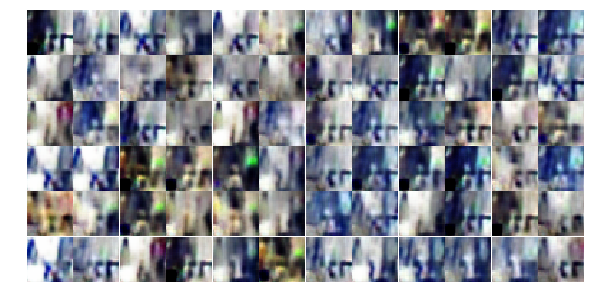

Epoch 14/25... Discriminator Loss: 0.0025... Generator Loss: 11.2347
Epoch 14/25... Discriminator Loss: 0.0451... Generator Loss: 5.3712
Epoch 14/25... Discriminator Loss: 0.1148... Generator Loss: 3.1533
Epoch 14/25... Discriminator Loss: 0.0558... Generator Loss: 4.4122
Epoch 14/25... Discriminator Loss: 0.0546... Generator Loss: 11.5719
Epoch 14/25... Discriminator Loss: 0.0015... Generator Loss: 10.4761
Epoch 14/25... Discriminator Loss: 0.0811... Generator Loss: 6.6588
Epoch 14/25... Discriminator Loss: 0.0067... Generator Loss: 8.0474
Epoch 14/25... Discriminator Loss: 0.0320... Generator Loss: 6.3949
Epoch 14/25... Discriminator Loss: 0.0034... Generator Loss: 9.5930


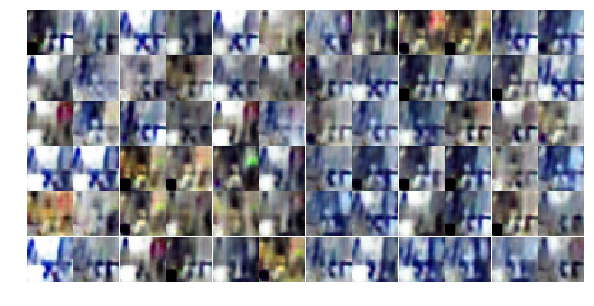

Epoch 14/25... Discriminator Loss: 0.1122... Generator Loss: 8.7738
Epoch 14/25... Discriminator Loss: 0.0090... Generator Loss: 8.6714
Epoch 14/25... Discriminator Loss: 0.0220... Generator Loss: 6.4270
Epoch 14/25... Discriminator Loss: 0.2203... Generator Loss: 1.9130
Epoch 14/25... Discriminator Loss: 0.0060... Generator Loss: 12.2814
Epoch 14/25... Discriminator Loss: 0.0026... Generator Loss: 11.2731
Epoch 14/25... Discriminator Loss: 0.0019... Generator Loss: 10.6719
Epoch 14/25... Discriminator Loss: 0.0103... Generator Loss: 9.7936
Epoch 14/25... Discriminator Loss: 0.0103... Generator Loss: 6.2712
Epoch 14/25... Discriminator Loss: 0.0064... Generator Loss: 7.6477


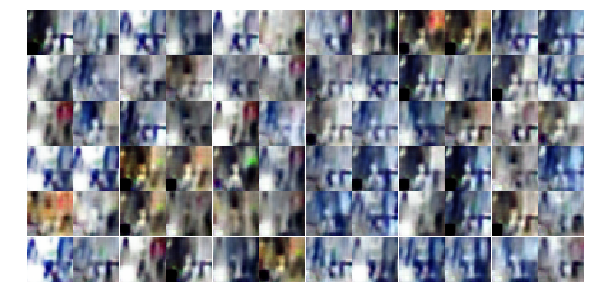

Epoch 14/25... Discriminator Loss: 0.0729... Generator Loss: 12.3236
Epoch 14/25... Discriminator Loss: 0.0073... Generator Loss: 11.7901
Epoch 14/25... Discriminator Loss: 0.0019... Generator Loss: 11.1819
Epoch 14/25... Discriminator Loss: 0.0081... Generator Loss: 9.2318
Epoch 14/25... Discriminator Loss: 0.0284... Generator Loss: 12.0664
Epoch 14/25... Discriminator Loss: 0.0185... Generator Loss: 4.3632
Epoch 14/25... Discriminator Loss: 0.2553... Generator Loss: 12.2623
Epoch 14/25... Discriminator Loss: 0.0017... Generator Loss: 9.3634
Epoch 14/25... Discriminator Loss: 0.0145... Generator Loss: 11.0239
Epoch 14/25... Discriminator Loss: 0.1023... Generator Loss: 12.2906


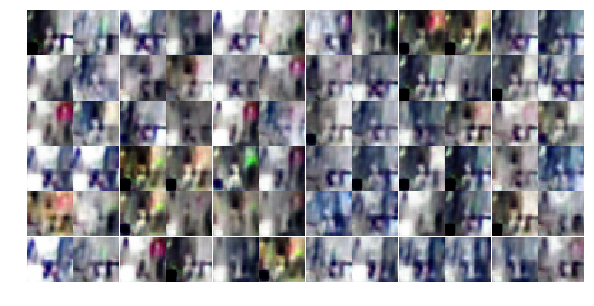

Epoch 14/25... Discriminator Loss: 0.0115... Generator Loss: 11.4034
Epoch 14/25... Discriminator Loss: 0.0021... Generator Loss: 7.2856
Epoch 14/25... Discriminator Loss: 0.0094... Generator Loss: 11.9516
Epoch 14/25... Discriminator Loss: 0.0133... Generator Loss: 11.3761
Epoch 14/25... Discriminator Loss: 0.0077... Generator Loss: 7.0138
Epoch 14/25... Discriminator Loss: 0.0039... Generator Loss: 9.9288
Epoch 14/25... Discriminator Loss: 0.0111... Generator Loss: 5.2705
Epoch 14/25... Discriminator Loss: 0.0155... Generator Loss: 12.7686
Epoch 14/25... Discriminator Loss: 0.0038... Generator Loss: 12.1432
Epoch 14/25... Discriminator Loss: 0.0008... Generator Loss: 10.7026


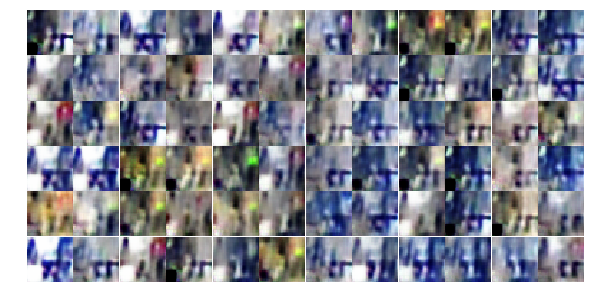

Epoch 14/25... Discriminator Loss: 0.0035... Generator Loss: 11.6425
Epoch 14/25... Discriminator Loss: 0.0060... Generator Loss: 11.4153
Epoch 15/25... Discriminator Loss: 0.0309... Generator Loss: 12.2460
Epoch 15/25... Discriminator Loss: 0.0148... Generator Loss: 4.7439
Epoch 15/25... Discriminator Loss: 0.0024... Generator Loss: 10.5321
Epoch 15/25... Discriminator Loss: 0.0028... Generator Loss: 7.6010
Epoch 15/25... Discriminator Loss: 0.0192... Generator Loss: 11.2873
Epoch 15/25... Discriminator Loss: 0.0119... Generator Loss: 12.0735
Epoch 15/25... Discriminator Loss: 0.0022... Generator Loss: 10.3385
Epoch 15/25... Discriminator Loss: 0.0094... Generator Loss: 11.0607


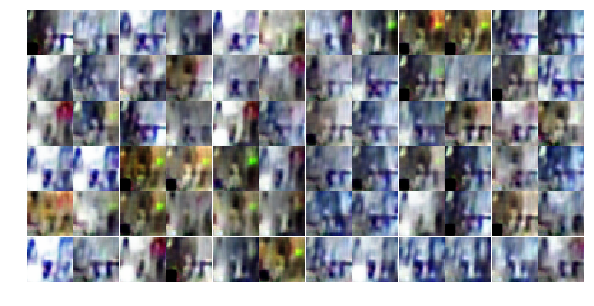

Epoch 15/25... Discriminator Loss: 0.0045... Generator Loss: 6.2152
Epoch 15/25... Discriminator Loss: 0.1403... Generator Loss: 10.5140
Epoch 15/25... Discriminator Loss: 0.0191... Generator Loss: 11.7773
Epoch 15/25... Discriminator Loss: 0.0055... Generator Loss: 10.6637
Epoch 15/25... Discriminator Loss: 0.0034... Generator Loss: 11.2023
Epoch 15/25... Discriminator Loss: 0.2095... Generator Loss: 2.0155
Epoch 15/25... Discriminator Loss: 0.0038... Generator Loss: 11.9038
Epoch 15/25... Discriminator Loss: 0.0074... Generator Loss: 9.3956
Epoch 15/25... Discriminator Loss: 0.0441... Generator Loss: 3.9417
Epoch 15/25... Discriminator Loss: 0.0094... Generator Loss: 12.1829


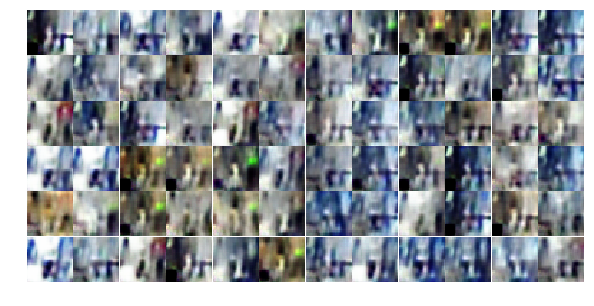

Epoch 15/25... Discriminator Loss: 0.0132... Generator Loss: 5.2008
Epoch 15/25... Discriminator Loss: 0.0047... Generator Loss: 11.3755
Epoch 15/25... Discriminator Loss: 0.0185... Generator Loss: 13.1890
Epoch 15/25... Discriminator Loss: 0.0010... Generator Loss: 12.2942
Epoch 15/25... Discriminator Loss: 0.0007... Generator Loss: 11.8404
Epoch 15/25... Discriminator Loss: 0.0013... Generator Loss: 10.4520
Epoch 15/25... Discriminator Loss: 0.0034... Generator Loss: 6.3933
Epoch 15/25... Discriminator Loss: 0.0029... Generator Loss: 11.8588
Epoch 15/25... Discriminator Loss: 0.0158... Generator Loss: 9.4710
Epoch 15/25... Discriminator Loss: 0.0032... Generator Loss: 9.8604


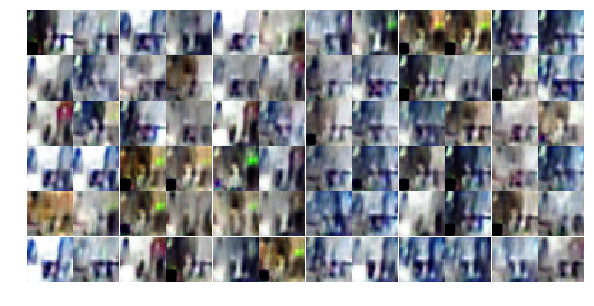

Epoch 15/25... Discriminator Loss: 0.0263... Generator Loss: 3.9848
Epoch 15/25... Discriminator Loss: 0.0025... Generator Loss: 12.1742
Epoch 15/25... Discriminator Loss: 0.0020... Generator Loss: 10.6140
Epoch 15/25... Discriminator Loss: 0.0051... Generator Loss: 7.0736
Epoch 15/25... Discriminator Loss: 0.0105... Generator Loss: 7.5697
Epoch 15/25... Discriminator Loss: 0.0090... Generator Loss: 6.2312
Epoch 15/25... Discriminator Loss: 0.1415... Generator Loss: 2.3022
Epoch 15/25... Discriminator Loss: 0.0064... Generator Loss: 11.5356
Epoch 15/25... Discriminator Loss: 0.0140... Generator Loss: 5.0404
Epoch 15/25... Discriminator Loss: 0.0138... Generator Loss: 13.0595


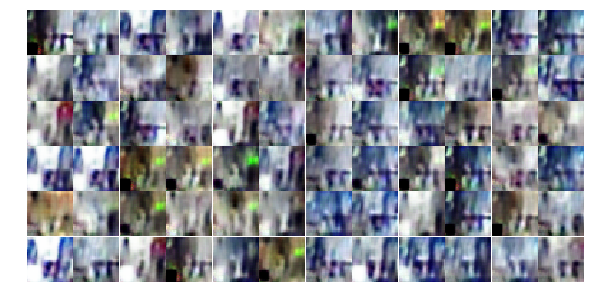

Epoch 15/25... Discriminator Loss: 0.0035... Generator Loss: 12.6771
Epoch 15/25... Discriminator Loss: 0.0009... Generator Loss: 11.6837
Epoch 15/25... Discriminator Loss: 0.0676... Generator Loss: 3.1274
Epoch 15/25... Discriminator Loss: 0.0109... Generator Loss: 12.6065
Epoch 15/25... Discriminator Loss: 0.0023... Generator Loss: 9.8901
Epoch 15/25... Discriminator Loss: 0.0006... Generator Loss: 11.1772
Epoch 15/25... Discriminator Loss: 0.0059... Generator Loss: 12.4950
Epoch 15/25... Discriminator Loss: 0.0021... Generator Loss: 12.2682
Epoch 15/25... Discriminator Loss: 0.0089... Generator Loss: 5.5100
Epoch 15/25... Discriminator Loss: 0.0030... Generator Loss: 6.7171


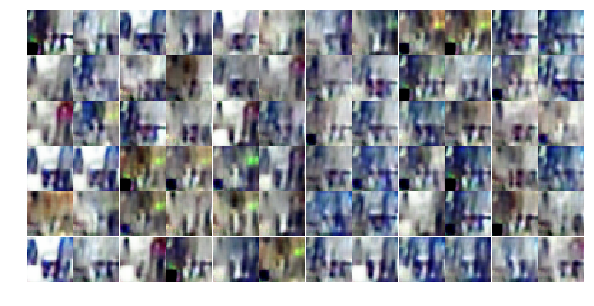

Epoch 15/25... Discriminator Loss: 0.0029... Generator Loss: 9.2445
Epoch 15/25... Discriminator Loss: 0.0020... Generator Loss: 9.0340
Epoch 15/25... Discriminator Loss: 0.0036... Generator Loss: 7.2634
Epoch 15/25... Discriminator Loss: 0.0030... Generator Loss: 11.0281
Epoch 15/25... Discriminator Loss: 0.5022... Generator Loss: 1.1147
Epoch 15/25... Discriminator Loss: 0.0035... Generator Loss: 7.3037
Epoch 15/25... Discriminator Loss: 0.0057... Generator Loss: 7.2421
Epoch 15/25... Discriminator Loss: 0.0175... Generator Loss: 9.3161
Epoch 15/25... Discriminator Loss: 0.0122... Generator Loss: 12.0234
Epoch 16/25... Discriminator Loss: 0.0031... Generator Loss: 11.2911


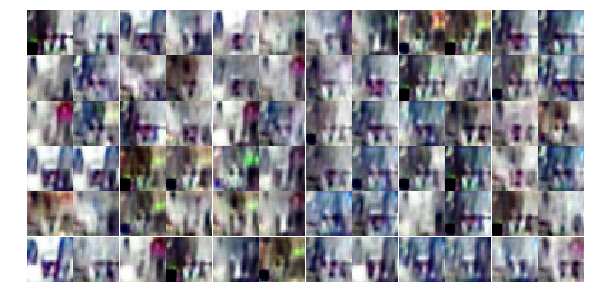

Epoch 16/25... Discriminator Loss: 0.0035... Generator Loss: 9.3925
Epoch 16/25... Discriminator Loss: 0.0042... Generator Loss: 12.5096
Epoch 16/25... Discriminator Loss: 0.2542... Generator Loss: 1.7021
Epoch 16/25... Discriminator Loss: 0.0023... Generator Loss: 13.0021
Epoch 16/25... Discriminator Loss: 0.0027... Generator Loss: 12.3467
Epoch 16/25... Discriminator Loss: 0.0017... Generator Loss: 11.0717
Epoch 16/25... Discriminator Loss: 0.0025... Generator Loss: 7.6570
Epoch 16/25... Discriminator Loss: 0.0013... Generator Loss: 11.7366
Epoch 16/25... Discriminator Loss: 0.0189... Generator Loss: 11.3336
Epoch 16/25... Discriminator Loss: 0.0726... Generator Loss: 3.7176


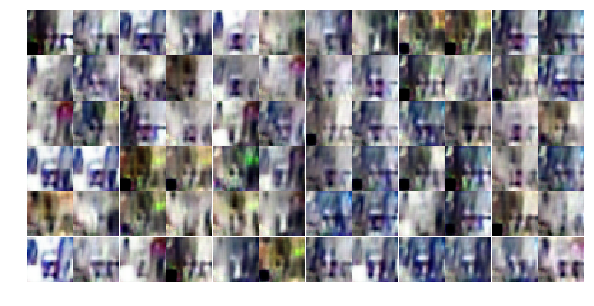

Epoch 16/25... Discriminator Loss: 0.0191... Generator Loss: 9.9337
Epoch 16/25... Discriminator Loss: 0.3689... Generator Loss: 1.5010
Epoch 16/25... Discriminator Loss: 0.0114... Generator Loss: 6.7266
Epoch 16/25... Discriminator Loss: 0.2794... Generator Loss: 12.1815
Epoch 16/25... Discriminator Loss: 0.0597... Generator Loss: 11.3213
Epoch 16/25... Discriminator Loss: 0.0042... Generator Loss: 10.4271
Epoch 16/25... Discriminator Loss: 0.0514... Generator Loss: 10.8650
Epoch 16/25... Discriminator Loss: 0.0179... Generator Loss: 7.3445
Epoch 16/25... Discriminator Loss: 0.0132... Generator Loss: 11.8398
Epoch 16/25... Discriminator Loss: 0.0067... Generator Loss: 6.4671


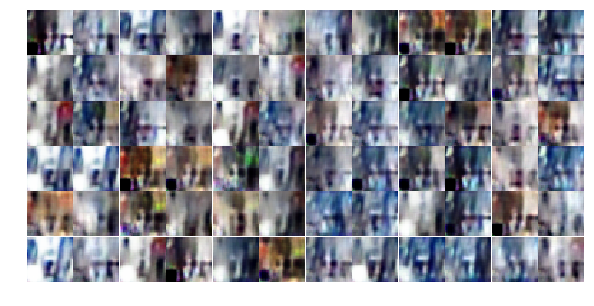

Epoch 16/25... Discriminator Loss: 0.0058... Generator Loss: 10.9109
Epoch 16/25... Discriminator Loss: 0.0865... Generator Loss: 12.3717
Epoch 16/25... Discriminator Loss: 0.0102... Generator Loss: 11.2080
Epoch 16/25... Discriminator Loss: 0.0286... Generator Loss: 4.0167
Epoch 16/25... Discriminator Loss: 0.0079... Generator Loss: 10.8328
Epoch 16/25... Discriminator Loss: 0.0027... Generator Loss: 7.7186
Epoch 16/25... Discriminator Loss: 0.0783... Generator Loss: 12.2357
Epoch 16/25... Discriminator Loss: 0.0058... Generator Loss: 10.3390
Epoch 16/25... Discriminator Loss: 0.0049... Generator Loss: 9.1255
Epoch 16/25... Discriminator Loss: 0.0256... Generator Loss: 4.0820


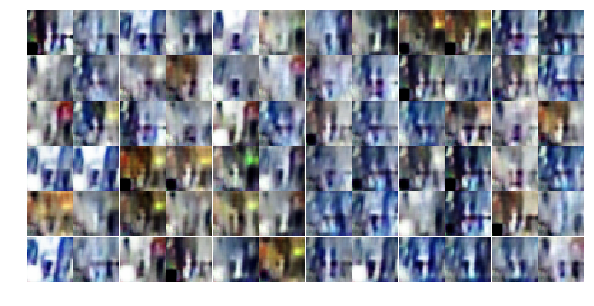

Epoch 16/25... Discriminator Loss: 0.0253... Generator Loss: 4.4770
Epoch 16/25... Discriminator Loss: 0.0139... Generator Loss: 8.8844
Epoch 16/25... Discriminator Loss: 0.0145... Generator Loss: 4.8182
Epoch 16/25... Discriminator Loss: 0.0436... Generator Loss: 3.4660
Epoch 16/25... Discriminator Loss: 0.0154... Generator Loss: 10.6447
Epoch 16/25... Discriminator Loss: 0.0875... Generator Loss: 2.7854
Epoch 16/25... Discriminator Loss: 0.0033... Generator Loss: 9.9311
Epoch 16/25... Discriminator Loss: 0.0013... Generator Loss: 10.5542
Epoch 16/25... Discriminator Loss: 0.0018... Generator Loss: 9.3721
Epoch 16/25... Discriminator Loss: 0.0188... Generator Loss: 11.8022


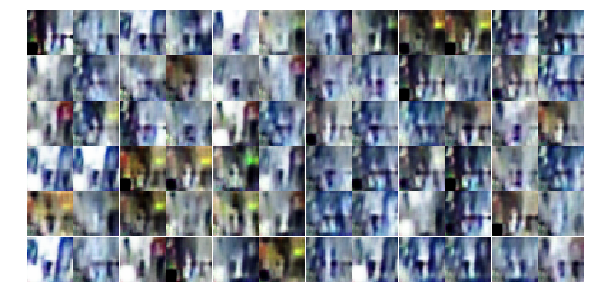

Epoch 16/25... Discriminator Loss: 0.0034... Generator Loss: 10.9941
Epoch 16/25... Discriminator Loss: 0.0018... Generator Loss: 9.6745
Epoch 16/25... Discriminator Loss: 0.0023... Generator Loss: 12.3235
Epoch 16/25... Discriminator Loss: 0.0039... Generator Loss: 8.0091
Epoch 16/25... Discriminator Loss: 0.0076... Generator Loss: 5.6362
Epoch 16/25... Discriminator Loss: 0.0024... Generator Loss: 11.1016
Epoch 16/25... Discriminator Loss: 0.0035... Generator Loss: 6.9233
Epoch 16/25... Discriminator Loss: 0.0275... Generator Loss: 12.1498
Epoch 16/25... Discriminator Loss: 0.0107... Generator Loss: 11.7704
Epoch 16/25... Discriminator Loss: 0.0051... Generator Loss: 5.9450


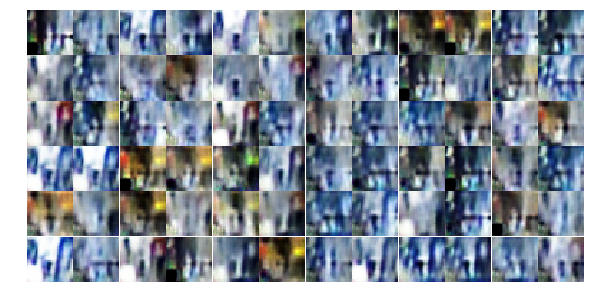

Epoch 16/25... Discriminator Loss: 0.0135... Generator Loss: 11.0623
Epoch 16/25... Discriminator Loss: 0.0047... Generator Loss: 10.8158
Epoch 16/25... Discriminator Loss: 0.0020... Generator Loss: 11.6107
Epoch 16/25... Discriminator Loss: 0.0028... Generator Loss: 9.4993
Epoch 16/25... Discriminator Loss: 0.0314... Generator Loss: 10.3167
Epoch 16/25... Discriminator Loss: 0.1708... Generator Loss: 6.2842
Epoch 17/25... Discriminator Loss: 0.0152... Generator Loss: 12.4103
Epoch 17/25... Discriminator Loss: 0.0055... Generator Loss: 12.3259
Epoch 17/25... Discriminator Loss: 0.0051... Generator Loss: 6.2130
Epoch 17/25... Discriminator Loss: 0.0033... Generator Loss: 12.5823


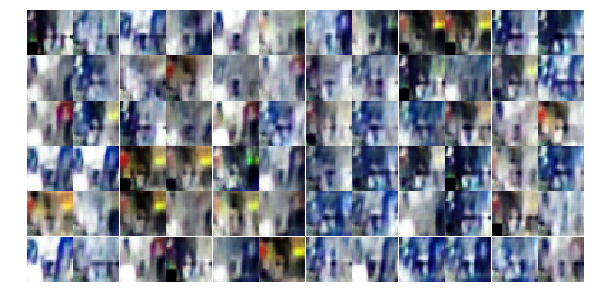

Epoch 17/25... Discriminator Loss: 0.0071... Generator Loss: 9.5116
Epoch 17/25... Discriminator Loss: 0.0183... Generator Loss: 12.0576
Epoch 17/25... Discriminator Loss: 0.1066... Generator Loss: 8.5853
Epoch 17/25... Discriminator Loss: 0.0098... Generator Loss: 12.0108
Epoch 17/25... Discriminator Loss: 0.0414... Generator Loss: 12.9459
Epoch 17/25... Discriminator Loss: 2.4745... Generator Loss: 0.1419
Epoch 17/25... Discriminator Loss: 0.0098... Generator Loss: 5.5357
Epoch 17/25... Discriminator Loss: 0.0029... Generator Loss: 11.5399
Epoch 17/25... Discriminator Loss: 0.1739... Generator Loss: 2.3927
Epoch 17/25... Discriminator Loss: 0.0070... Generator Loss: 12.5958


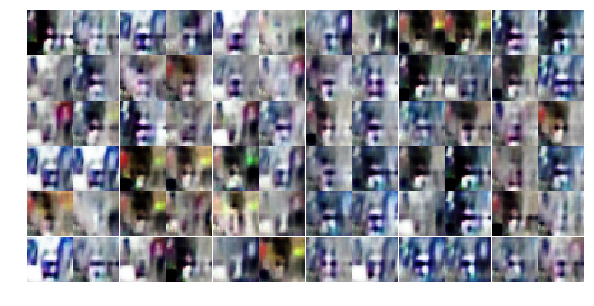

Epoch 17/25... Discriminator Loss: 0.0041... Generator Loss: 11.4579
Epoch 17/25... Discriminator Loss: 0.0371... Generator Loss: 4.1220
Epoch 17/25... Discriminator Loss: 0.0110... Generator Loss: 12.6242
Epoch 17/25... Discriminator Loss: 0.0023... Generator Loss: 11.0302
Epoch 17/25... Discriminator Loss: 0.0277... Generator Loss: 12.8184
Epoch 17/25... Discriminator Loss: 0.0009... Generator Loss: 9.0897
Epoch 17/25... Discriminator Loss: 0.0096... Generator Loss: 5.6140
Epoch 17/25... Discriminator Loss: 0.0044... Generator Loss: 11.3583
Epoch 17/25... Discriminator Loss: 0.0059... Generator Loss: 11.7534
Epoch 17/25... Discriminator Loss: 0.0018... Generator Loss: 10.7500


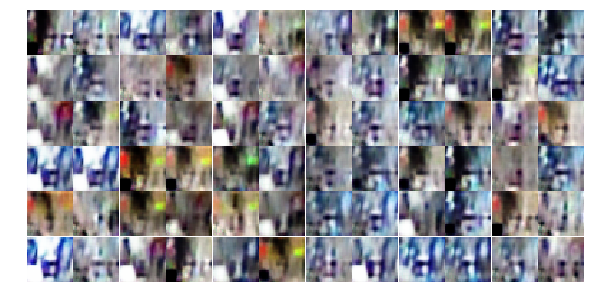

Epoch 17/25... Discriminator Loss: 0.0010... Generator Loss: 9.3548
Epoch 17/25... Discriminator Loss: 0.0509... Generator Loss: 9.9706
Epoch 17/25... Discriminator Loss: 0.0039... Generator Loss: 12.5483
Epoch 17/25... Discriminator Loss: 0.0024... Generator Loss: 11.1206
Epoch 17/25... Discriminator Loss: 0.0004... Generator Loss: 12.0345
Epoch 17/25... Discriminator Loss: 0.7507... Generator Loss: 0.8242
Epoch 17/25... Discriminator Loss: 0.0009... Generator Loss: 10.4681
Epoch 17/25... Discriminator Loss: 0.0026... Generator Loss: 8.6016
Epoch 17/25... Discriminator Loss: 0.0233... Generator Loss: 11.0941
Epoch 17/25... Discriminator Loss: 0.0058... Generator Loss: 12.7422


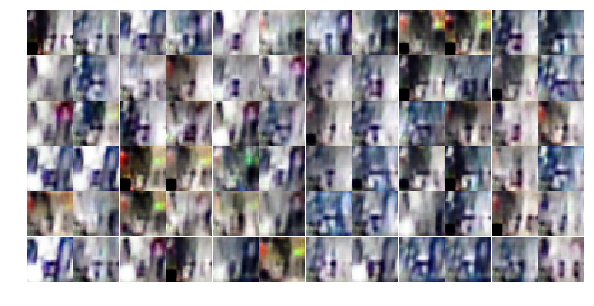

Epoch 17/25... Discriminator Loss: 0.0025... Generator Loss: 9.4878
Epoch 17/25... Discriminator Loss: 0.0017... Generator Loss: 9.6444
Epoch 17/25... Discriminator Loss: 0.0897... Generator Loss: 2.9124
Epoch 17/25... Discriminator Loss: 0.3838... Generator Loss: 11.1016
Epoch 17/25... Discriminator Loss: 0.0405... Generator Loss: 9.7175
Epoch 17/25... Discriminator Loss: 0.7057... Generator Loss: 0.8237
Epoch 17/25... Discriminator Loss: 0.0035... Generator Loss: 10.3779
Epoch 17/25... Discriminator Loss: 0.0160... Generator Loss: 11.0006
Epoch 17/25... Discriminator Loss: 0.0043... Generator Loss: 12.1857
Epoch 17/25... Discriminator Loss: 0.0041... Generator Loss: 11.0534


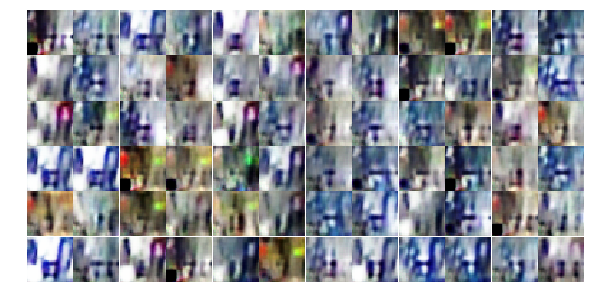

Epoch 17/25... Discriminator Loss: 0.0054... Generator Loss: 8.8355
Epoch 17/25... Discriminator Loss: 0.0054... Generator Loss: 11.2319
Epoch 17/25... Discriminator Loss: 0.0394... Generator Loss: 10.2836
Epoch 17/25... Discriminator Loss: 0.0065... Generator Loss: 10.8530
Epoch 17/25... Discriminator Loss: 0.0058... Generator Loss: 10.6912
Epoch 17/25... Discriminator Loss: 0.0269... Generator Loss: 4.0369
Epoch 17/25... Discriminator Loss: 0.0112... Generator Loss: 11.7016
Epoch 17/25... Discriminator Loss: 0.0095... Generator Loss: 11.9737
Epoch 17/25... Discriminator Loss: 0.1236... Generator Loss: 2.3999
Epoch 17/25... Discriminator Loss: 0.7317... Generator Loss: 0.8035


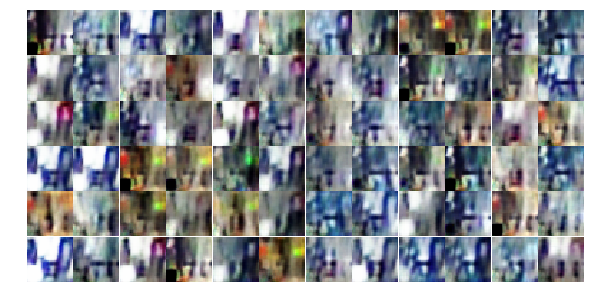

Epoch 17/25... Discriminator Loss: 0.0447... Generator Loss: 12.6819
Epoch 17/25... Discriminator Loss: 0.0029... Generator Loss: 12.3616
Epoch 17/25... Discriminator Loss: 0.0076... Generator Loss: 9.2173
Epoch 17/25... Discriminator Loss: 0.0101... Generator Loss: 6.1208
Epoch 18/25... Discriminator Loss: 0.0022... Generator Loss: 10.9202
Epoch 18/25... Discriminator Loss: 0.0104... Generator Loss: 13.2682
Epoch 18/25... Discriminator Loss: 0.0029... Generator Loss: 12.5941
Epoch 18/25... Discriminator Loss: 0.0453... Generator Loss: 3.4375
Epoch 18/25... Discriminator Loss: 0.0067... Generator Loss: 5.5027
Epoch 18/25... Discriminator Loss: 0.0019... Generator Loss: 10.1164


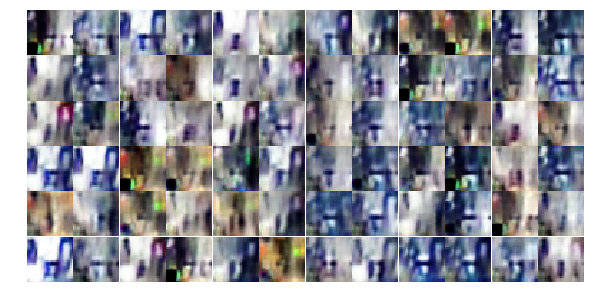

Epoch 18/25... Discriminator Loss: 0.0089... Generator Loss: 12.7184
Epoch 18/25... Discriminator Loss: 0.0072... Generator Loss: 11.3405
Epoch 18/25... Discriminator Loss: 0.0022... Generator Loss: 11.4230
Epoch 18/25... Discriminator Loss: 0.0016... Generator Loss: 10.4025
Epoch 18/25... Discriminator Loss: 0.0042... Generator Loss: 12.6635
Epoch 18/25... Discriminator Loss: 0.0013... Generator Loss: 9.2681
Epoch 18/25... Discriminator Loss: 0.0048... Generator Loss: 10.7700
Epoch 18/25... Discriminator Loss: 0.0215... Generator Loss: 13.7000
Epoch 18/25... Discriminator Loss: 0.0013... Generator Loss: 13.1630
Epoch 18/25... Discriminator Loss: 0.0041... Generator Loss: 12.5731


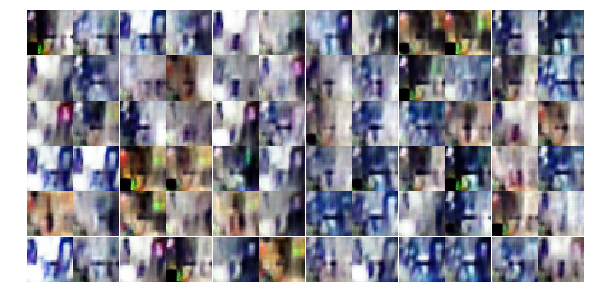

Epoch 18/25... Discriminator Loss: 0.0008... Generator Loss: 12.1741
Epoch 18/25... Discriminator Loss: 0.0014... Generator Loss: 11.6152
Epoch 18/25... Discriminator Loss: 0.0027... Generator Loss: 10.5931
Epoch 18/25... Discriminator Loss: 0.0025... Generator Loss: 7.5728
Epoch 18/25... Discriminator Loss: 0.0183... Generator Loss: 12.7830
Epoch 18/25... Discriminator Loss: 0.0018... Generator Loss: 11.5473
Epoch 18/25... Discriminator Loss: 0.0052... Generator Loss: 7.6807
Epoch 18/25... Discriminator Loss: 0.0024... Generator Loss: 13.2812
Epoch 18/25... Discriminator Loss: 0.0067... Generator Loss: 12.7423
Epoch 18/25... Discriminator Loss: 0.0024... Generator Loss: 10.6380


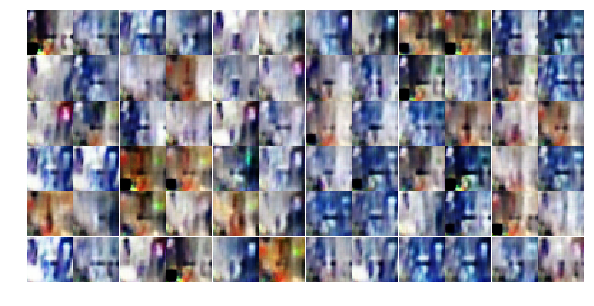

Epoch 18/25... Discriminator Loss: 0.0283... Generator Loss: 4.1155
Epoch 18/25... Discriminator Loss: 0.0151... Generator Loss: 4.6692
Epoch 18/25... Discriminator Loss: 0.0016... Generator Loss: 8.7446
Epoch 18/25... Discriminator Loss: 0.0029... Generator Loss: 12.9680
Epoch 18/25... Discriminator Loss: 0.0012... Generator Loss: 10.6683
Epoch 18/25... Discriminator Loss: 0.0094... Generator Loss: 5.2796
Epoch 18/25... Discriminator Loss: 0.0150... Generator Loss: 13.8080
Epoch 18/25... Discriminator Loss: 0.0030... Generator Loss: 13.5497
Epoch 18/25... Discriminator Loss: 0.0013... Generator Loss: 12.9409
Epoch 18/25... Discriminator Loss: 0.0011... Generator Loss: 12.3352


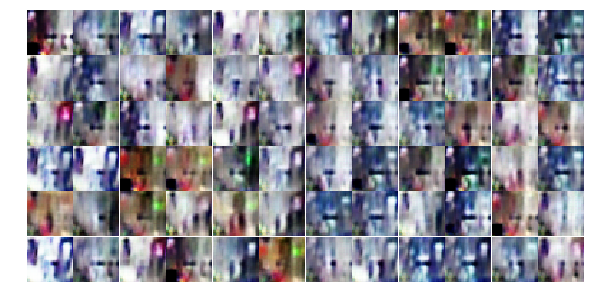

Epoch 18/25... Discriminator Loss: 0.0062... Generator Loss: 6.3568
Epoch 18/25... Discriminator Loss: 0.0063... Generator Loss: 12.0859
Epoch 18/25... Discriminator Loss: 0.0024... Generator Loss: 7.1410
Epoch 18/25... Discriminator Loss: 0.2337... Generator Loss: 10.6437
Epoch 18/25... Discriminator Loss: 0.3664... Generator Loss: 11.3696
Epoch 18/25... Discriminator Loss: 0.0065... Generator Loss: 10.0324
Epoch 18/25... Discriminator Loss: 0.0049... Generator Loss: 9.8443
Epoch 18/25... Discriminator Loss: 0.0163... Generator Loss: 12.0129
Epoch 18/25... Discriminator Loss: 0.0035... Generator Loss: 10.4109
Epoch 18/25... Discriminator Loss: 0.0259... Generator Loss: 6.6671


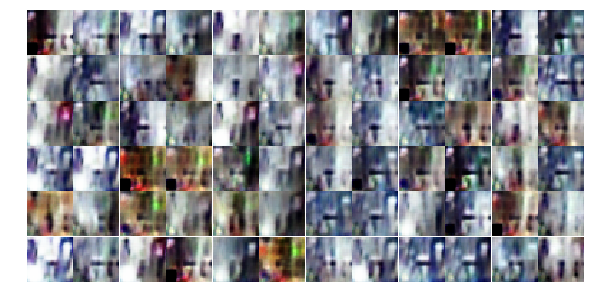

Epoch 18/25... Discriminator Loss: 0.0013... Generator Loss: 11.7795
Epoch 18/25... Discriminator Loss: 0.0636... Generator Loss: 9.8590
Epoch 18/25... Discriminator Loss: 0.0112... Generator Loss: 5.9360
Epoch 18/25... Discriminator Loss: 0.0311... Generator Loss: 12.8668
Epoch 18/25... Discriminator Loss: 0.0059... Generator Loss: 10.7746
Epoch 18/25... Discriminator Loss: 0.1443... Generator Loss: 7.2194
Epoch 18/25... Discriminator Loss: 0.0527... Generator Loss: 13.4387
Epoch 18/25... Discriminator Loss: 0.0034... Generator Loss: 12.7271
Epoch 18/25... Discriminator Loss: 0.0996... Generator Loss: 2.7270
Epoch 18/25... Discriminator Loss: 0.0048... Generator Loss: 11.1461


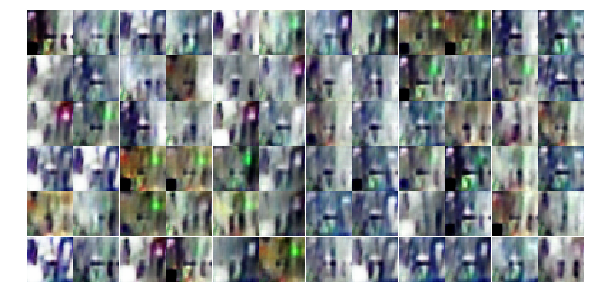

Epoch 18/25... Discriminator Loss: 0.0134... Generator Loss: 9.6211
Epoch 19/25... Discriminator Loss: 0.0019... Generator Loss: 10.4217
Epoch 19/25... Discriminator Loss: 0.0037... Generator Loss: 11.1104
Epoch 19/25... Discriminator Loss: 0.0028... Generator Loss: 6.9182
Epoch 19/25... Discriminator Loss: 0.0027... Generator Loss: 12.1880
Epoch 19/25... Discriminator Loss: 0.0030... Generator Loss: 12.4530
Epoch 19/25... Discriminator Loss: 0.0082... Generator Loss: 6.8725
Epoch 19/25... Discriminator Loss: 0.0347... Generator Loss: 3.8916
Epoch 19/25... Discriminator Loss: 0.0018... Generator Loss: 10.6825
Epoch 19/25... Discriminator Loss: 0.0075... Generator Loss: 10.3349


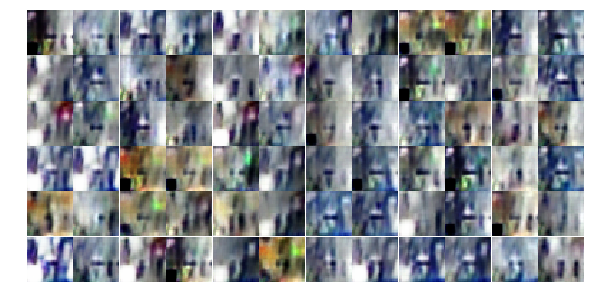

Epoch 19/25... Discriminator Loss: 0.0020... Generator Loss: 13.1958
Epoch 19/25... Discriminator Loss: 0.0489... Generator Loss: 3.4951
Epoch 19/25... Discriminator Loss: 0.0187... Generator Loss: 4.4640
Epoch 19/25... Discriminator Loss: 0.0200... Generator Loss: 12.2749
Epoch 19/25... Discriminator Loss: 0.0135... Generator Loss: 12.7402
Epoch 19/25... Discriminator Loss: 0.0006... Generator Loss: 13.0608
Epoch 19/25... Discriminator Loss: 0.0016... Generator Loss: 10.3922
Epoch 19/25... Discriminator Loss: 0.0086... Generator Loss: 8.3464
Epoch 19/25... Discriminator Loss: 0.0064... Generator Loss: 6.5023
Epoch 19/25... Discriminator Loss: 0.0016... Generator Loss: 8.9697


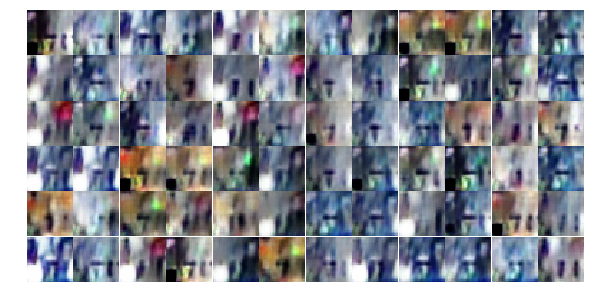

Epoch 19/25... Discriminator Loss: 1.5392... Generator Loss: 0.4309
Epoch 19/25... Discriminator Loss: 0.0194... Generator Loss: 4.3640
Epoch 19/25... Discriminator Loss: 0.0023... Generator Loss: 11.5258
Epoch 19/25... Discriminator Loss: 0.7559... Generator Loss: 11.8017
Epoch 19/25... Discriminator Loss: 0.4004... Generator Loss: 1.3832
Epoch 19/25... Discriminator Loss: 0.0072... Generator Loss: 10.0799
Epoch 19/25... Discriminator Loss: 0.0382... Generator Loss: 4.1134
Epoch 19/25... Discriminator Loss: 0.0368... Generator Loss: 11.1763
Epoch 19/25... Discriminator Loss: 0.0140... Generator Loss: 6.1496
Epoch 19/25... Discriminator Loss: 0.0497... Generator Loss: 8.3130


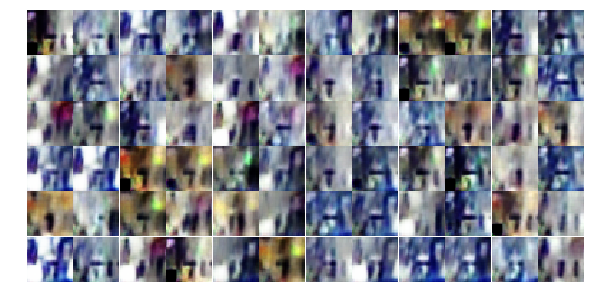

Epoch 19/25... Discriminator Loss: 0.0056... Generator Loss: 8.8975
Epoch 19/25... Discriminator Loss: 0.0401... Generator Loss: 3.5304
Epoch 19/25... Discriminator Loss: 0.0069... Generator Loss: 7.0469
Epoch 19/25... Discriminator Loss: 0.1762... Generator Loss: 2.1230
Epoch 19/25... Discriminator Loss: 0.0219... Generator Loss: 6.0956
Epoch 19/25... Discriminator Loss: 0.0174... Generator Loss: 12.7312
Epoch 19/25... Discriminator Loss: 0.0037... Generator Loss: 9.1482
Epoch 19/25... Discriminator Loss: 0.0076... Generator Loss: 9.0953
Epoch 19/25... Discriminator Loss: 0.0032... Generator Loss: 12.8974
Epoch 19/25... Discriminator Loss: 0.0013... Generator Loss: 12.4681


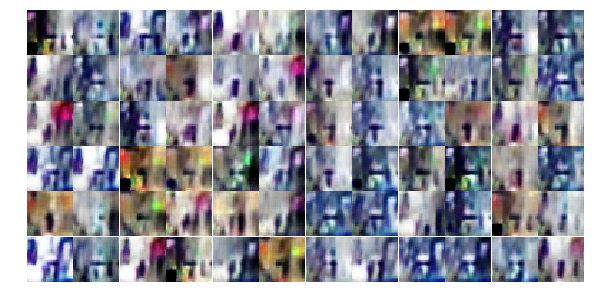

Epoch 19/25... Discriminator Loss: 0.0144... Generator Loss: 11.7624
Epoch 19/25... Discriminator Loss: 0.0087... Generator Loss: 8.0558
Epoch 19/25... Discriminator Loss: 0.0020... Generator Loss: 10.3000
Epoch 19/25... Discriminator Loss: 0.0046... Generator Loss: 12.3612
Epoch 19/25... Discriminator Loss: 0.0466... Generator Loss: 3.3080
Epoch 19/25... Discriminator Loss: 0.0017... Generator Loss: 8.4012
Epoch 19/25... Discriminator Loss: 0.0026... Generator Loss: 10.8100
Epoch 19/25... Discriminator Loss: 0.0246... Generator Loss: 9.8747
Epoch 19/25... Discriminator Loss: 0.0031... Generator Loss: 9.9884
Epoch 19/25... Discriminator Loss: 0.0094... Generator Loss: 11.5621


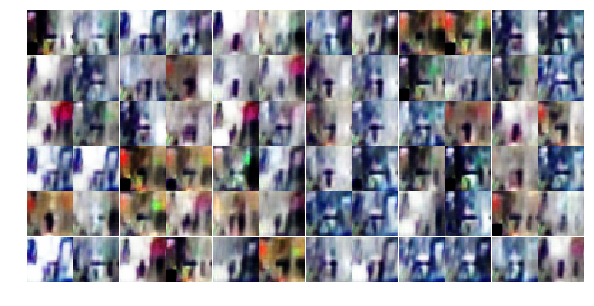

Epoch 19/25... Discriminator Loss: 0.0044... Generator Loss: 11.2339
Epoch 19/25... Discriminator Loss: 0.0230... Generator Loss: 12.3640
Epoch 19/25... Discriminator Loss: 0.0040... Generator Loss: 12.3398
Epoch 19/25... Discriminator Loss: 0.0007... Generator Loss: 11.6033
Epoch 19/25... Discriminator Loss: 0.0091... Generator Loss: 9.5266
Epoch 19/25... Discriminator Loss: 0.0234... Generator Loss: 7.7456
Epoch 19/25... Discriminator Loss: 0.0160... Generator Loss: 5.9642
Epoch 19/25... Discriminator Loss: 0.0016... Generator Loss: 13.5430
Epoch 20/25... Discriminator Loss: 0.0028... Generator Loss: 13.0825
Epoch 20/25... Discriminator Loss: 0.0007... Generator Loss: 13.1735


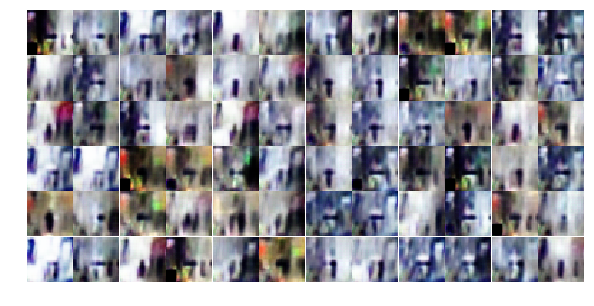

Epoch 20/25... Discriminator Loss: 0.0005... Generator Loss: 12.7318
Epoch 20/25... Discriminator Loss: 0.0013... Generator Loss: 12.0728
Epoch 20/25... Discriminator Loss: 0.0037... Generator Loss: 6.5171
Epoch 20/25... Discriminator Loss: 0.0087... Generator Loss: 6.4533
Epoch 20/25... Discriminator Loss: 0.0023... Generator Loss: 10.3071
Epoch 20/25... Discriminator Loss: 0.0016... Generator Loss: 13.1068
Epoch 20/25... Discriminator Loss: 0.0011... Generator Loss: 12.1971
Epoch 20/25... Discriminator Loss: 0.0009... Generator Loss: 11.9034
Epoch 20/25... Discriminator Loss: 0.0009... Generator Loss: 11.4971
Epoch 20/25... Discriminator Loss: 0.0010... Generator Loss: 9.8536


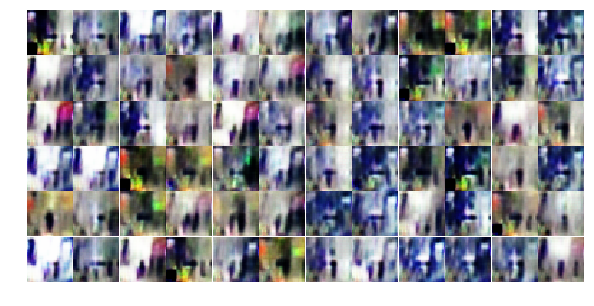

Epoch 20/25... Discriminator Loss: 0.0039... Generator Loss: 8.9788
Epoch 20/25... Discriminator Loss: 0.0209... Generator Loss: 13.3377
Epoch 20/25... Discriminator Loss: 0.0012... Generator Loss: 12.4303
Epoch 20/25... Discriminator Loss: 0.0030... Generator Loss: 7.4483
Epoch 20/25... Discriminator Loss: 0.0074... Generator Loss: 13.4934
Epoch 20/25... Discriminator Loss: 0.0008... Generator Loss: 10.3913
Epoch 20/25... Discriminator Loss: 0.0167... Generator Loss: 4.5447
Epoch 20/25... Discriminator Loss: 0.0019... Generator Loss: 11.8214
Epoch 20/25... Discriminator Loss: 0.0046... Generator Loss: 11.7742
Epoch 20/25... Discriminator Loss: 0.0008... Generator Loss: 9.2720


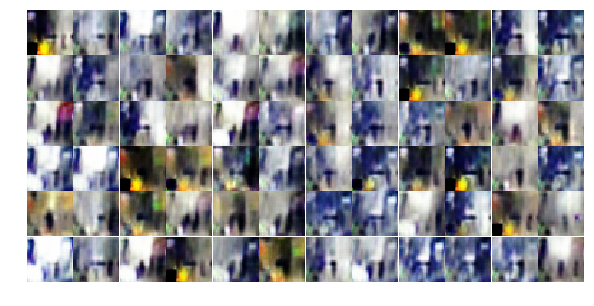

Epoch 20/25... Discriminator Loss: 0.0015... Generator Loss: 12.3243
Epoch 20/25... Discriminator Loss: 0.0006... Generator Loss: 11.7919
Epoch 20/25... Discriminator Loss: 0.0011... Generator Loss: 11.0815
Epoch 20/25... Discriminator Loss: 1.4329... Generator Loss: 0.4936
Epoch 20/25... Discriminator Loss: 0.2375... Generator Loss: 1.9278
Epoch 20/25... Discriminator Loss: 0.0046... Generator Loss: 10.4268
Epoch 20/25... Discriminator Loss: 0.0465... Generator Loss: 8.4071
Epoch 20/25... Discriminator Loss: 0.0125... Generator Loss: 11.4032
Epoch 20/25... Discriminator Loss: 0.0097... Generator Loss: 5.6048
Epoch 20/25... Discriminator Loss: 0.6884... Generator Loss: 0.8739


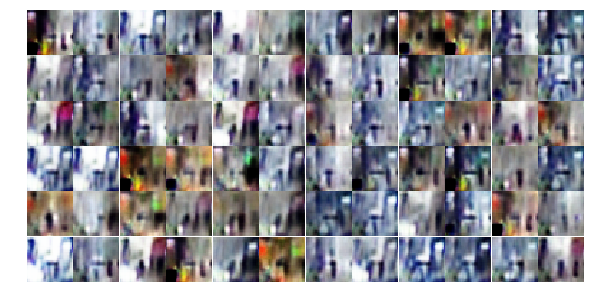

Epoch 20/25... Discriminator Loss: 1.8220... Generator Loss: 0.2354
Epoch 20/25... Discriminator Loss: 0.2260... Generator Loss: 11.7076
Epoch 20/25... Discriminator Loss: 0.0023... Generator Loss: 8.5577
Epoch 20/25... Discriminator Loss: 0.0204... Generator Loss: 10.7408
Epoch 20/25... Discriminator Loss: 0.0209... Generator Loss: 5.2361
Epoch 20/25... Discriminator Loss: 0.0051... Generator Loss: 10.0984
Epoch 20/25... Discriminator Loss: 0.1858... Generator Loss: 12.0665


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))